## Sim Demo

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

/ext3/miniconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
2025-03-19 19:04:10.195895: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-03-19 19:04:11.457600: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-03-19 19:04:13.029536: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [3]:
# overall imports
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

#### Check job specs

In [4]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 19.9%
RAM Usage: 25.6%
Available RAM: 749.0G
Total RAM: 1007.0G
52.4G


In [5]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))
os.environ["CUDA_VISIBLE_DEVICES"] = "0,1"

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.00 GB


In [6]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [7]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

#### Simulation tests <a id="sims"></a>

Random

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (390, 7380)
X_pca shape: (390, 27)
Y_sc shape: (390, 390)
Y_sc_spectralL shape: (390, 455)
Y_sc_spectralA shape: (390, 456)
Y_fc shape: (390, 390)
Coordinates shape: (390, 3)
Y shape (390, 390)
feature_name:  euclidean
processing_type:  None
features ['euclidean']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin


2
3
4
Create sweep with ID: qxd1700r
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/qxd1700r
sweep_id qxd1700r


wandb: Agent Starting Run: rauulnrz with config:
wandb: 	batch_size: 64
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 100
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 0.0001
wandb: 	weight_decay: 1e-05
ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.00 GB
Best val loss so far at epoch 1: 0.0325
Best val loss so far at epoch 2: 0.0288
Best val loss so far at epoch 3: 0.0283
Best val loss so far at epoch 4: 0.0282
Epoch 5/100, Train Loss: 0.0306, Val Loss: 0.0280
Best val loss so far at epoch 5: 0.0280
Best val loss so far at epoch 6: 0.0276
Best val loss so far at epoch 7: 0.0271
Epoch 10/100, Train Loss: 0.0278, Val Loss: 0.0269
Best val loss so far at epoch 10: 0.0269
Best val loss so far at epoch 11: 0.0267
Best val loss so far at epoch 12: 0.0265
Epoch 15/100, Train Loss: 0.0264, Val Loss: 0.0260
Best val loss so far at epoch 15: 0.0260
Best val loss so far at epoch 16: 0.0255
Best val loss so far at epoch 19: 0.0254
Epoch 20/100, Train Loss: 0.0254, Val Loss: 0.0255
Best val loss so far at epoch 22: 0.0253
Best val loss so far at epoch 23: 0.0252
Best val loss so far at epoch 24: 0.0249
Epoch 25/100, Train Loss: 0.

  from IPython.core.display import HTML, display  # type: ignore



fold0_epoch,▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇█
fold0_train_loss,█▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▅▅▄▄▃▄▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,81
fold0_train_loss,0.02271
fold0_val_loss,0.02352
inner_fold,0
mean_train_loss,0.02271


wandb: Agent Starting Run: 9xycrrac with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 100
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0471
Best val loss so far at epoch 2: 0.0401
Best val loss so far at epoch 3: 0.0362
Best val loss so far at epoch 4: 0.0335


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Epoch 5/100, Train Loss: 0.1140, Val Loss: 0.0325
Best val loss so far at epoch 5: 0.0325
Best val loss so far at epoch 6: 0.0308
Best val loss so far at epoch 7: 0.0301
Best val loss so far at epoch 9: 0.0292
Epoch 10/100, Train Loss: 0.0622, Val Loss: 0.0288
Best val loss so far at epoch 10: 0.0288
Best val loss so far at epoch 11: 0.0284
Best val loss so far at epoch 12: 0.0283
Best val loss so far at epoch 13: 0.0280
Best val loss so far at epoch 14: 0.0277
Epoch 15/100, Train Loss: 0.0416, Val Loss: 0.0277
Best val loss so far at epoch 15: 0.0277
Best val loss so far at epoch 16: 0.0275
Best val loss so far at epoch 18: 0.0274
Epoch 20/100, Train Loss: 0.0327, Val Loss: 0.0274
Best val loss so far at epoch 21: 0.0273
Best val loss so far at epoch 23: 0.0273
Epoch 25/100, Train Loss: 0.0299, Val Loss: 0.0273
Best val loss so far at epoch 26: 0.0272
Best val loss so far at epoch 27: 0.0272

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.027142
Best val loss so far at epoch 28: 0.027

fold0_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
fold0_train_loss,█▇▆▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▆▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,99
fold0_train_loss,0.02769
fold0_val_loss,0.02648
inner_fold,0
mean_train_loss,0.02769


wandb: Agent Starting Run: d6qpy1tr with config:
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 100
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0338
Best val loss so far at epoch 2: 0.0304


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 3: 0.0287
Best val loss so far at epoch 4: 0.0275
Epoch 5/100, Train Loss: 0.0424, Val Loss: 0.0270
Best val loss so far at epoch 5: 0.0270
Best val loss so far at epoch 6: 0.0261
Best val loss so far at epoch 7: 0.0261
Best val loss so far at epoch 8: 0.0258
Epoch 10/100, Train Loss: 0.0303, Val Loss: 0.0254
Best val loss so far at epoch 10: 0.0254
Best val loss so far at epoch 11: 0.0253
Best val loss so far at epoch 14: 0.0252
Epoch 15/100, Train Loss: 0.0254, Val Loss: 0.0253
Best val loss so far at epoch 16: 0.0248
Best val loss so far at epoch 19: 0.0247
Epoch 20/100, Train Loss: 0.0232, Val Loss: 0.0246
Best val loss so far at epoch 20: 0.0246
Best val loss so far at epoch 21: 0.0245
Best val loss so far at epoch 22: 0.0244
Best val loss so far at epoch 24: 0.0240
Epoch 25/100, Train Loss: 0.0222, Val Loss: 0.0243
Best val loss so far at epoch 28: 0.0240
Epoch 30/100, Train Loss: 0.0212, Val Loss: 0.0239
Best val loss so far at epoch 30: 0.0239

LR 

fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇████
fold0_train_loss,█▅▄▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,99
fold0_train_loss,0.0189
fold0_val_loss,0.02284
inner_fold,0
mean_train_loss,0.0189


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 50epb2qt with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 75
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 0.0001
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0384
Best val loss so far at epoch 2: 0.0325
Best val loss so far at epoch 3: 0.0316
Best val loss so far at epoch 4: 0.0300
Epoch 5/75, Train Loss: 0.1074, Val Loss: 0.0291
Best val loss so far at epoch 5: 0.0291
Best val loss so far at epoch 6: 0.0284


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 7: 0.0283
Best val loss so far at epoch 8: 0.0277
Best val loss so far at epoch 9: 0.0274
Epoch 10/75, Train Loss: 0.0561, Val Loss: 0.0273
Best val loss so far at epoch 10: 0.0273
Best val loss so far at epoch 11: 0.0273
Best val loss so far at epoch 12: 0.0270
Best val loss so far at epoch 14: 0.0270
Epoch 15/75, Train Loss: 0.0373, Val Loss: 0.0268
Best val loss so far at epoch 15: 0.0268
Best val loss so far at epoch 16: 0.0267
Epoch 20/75, Train Loss: 0.0309, Val Loss: 0.0268
Best val loss so far at epoch 22: 0.0266
Epoch 25/75, Train Loss: 0.0288, Val Loss: 0.0267

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.026656
Best val loss so far at epoch 28: 0.0266
Epoch 30/75, Train Loss: 0.0282, Val Loss: 0.0266
Best val loss so far at epoch 30: 0.0266
Best val loss so far at epoch 33: 0.0265
Epoch 35/75, Train Loss: 0.0282, Val Loss: 0.0265
Best val loss so far at epoch 36: 0.0265
Best val loss so far at epoch 38: 0.0264
Epoch 40/75, Train Loss: 0.0278, 

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇████
fold0_train_loss,█▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,74
fold0_train_loss,0.02668
fold0_val_loss,0.02608
inner_fold,0
mean_train_loss,0.02668


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 100, 'binarize': False, 'input_dim': 6, 'batch_size': 256, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.1, 'weight_decay': 1e-05, 'learning_rate': 9e-05}
Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0277
Best val loss so far at epoch 2: 0.0249
Best val loss so far at epoch 3: 0.0241
Best val loss so far at epoch 4: 0.0230
Epoch 5/100, Train Loss: 0.0339, Val Loss: 0.0225
Best val loss so far at epoch 5: 0.0225
Best val loss so far at epoch 6: 0.0225
Best val loss so far at epoch 7: 0.0222
Best val loss so far at epoch 8: 0.0219
Best val loss so far at epoch 9: 0.0218
Epoch 10/100, Train Loss: 0.0247, Val Loss: 0.0217
Best val loss so far at epoch 10: 0.0217
Best val loss so far at epoch 11: 0.0214
Best val loss so far at epoch 12: 0.0213
Best val loss so far at epoch 13: 0.0212
Best val loss so far at epoch 14: 0.0210
Epoch 15/100, Train Loss: 0.022

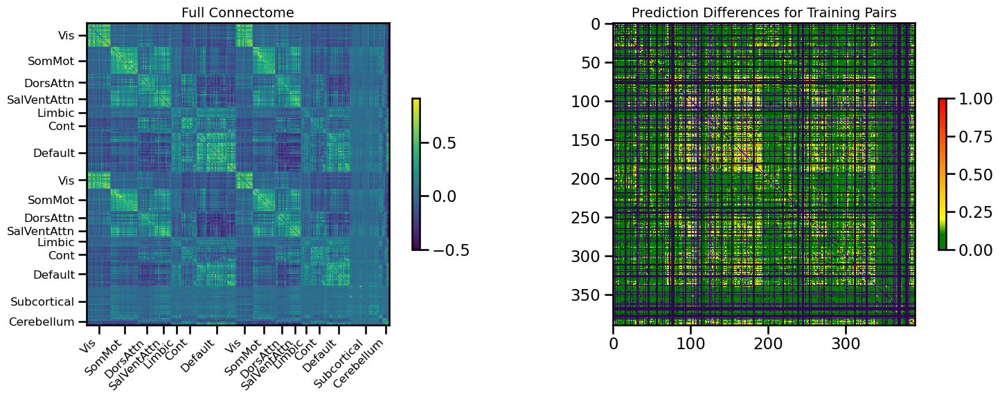

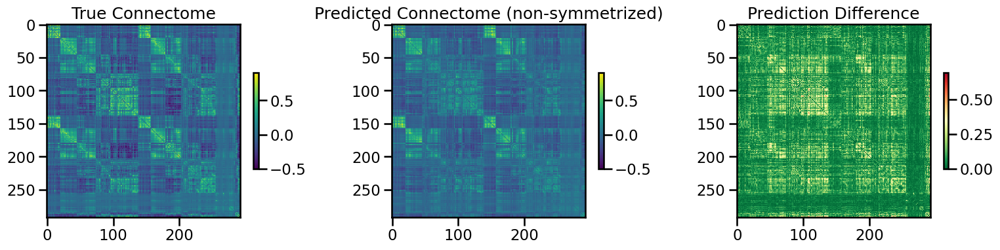

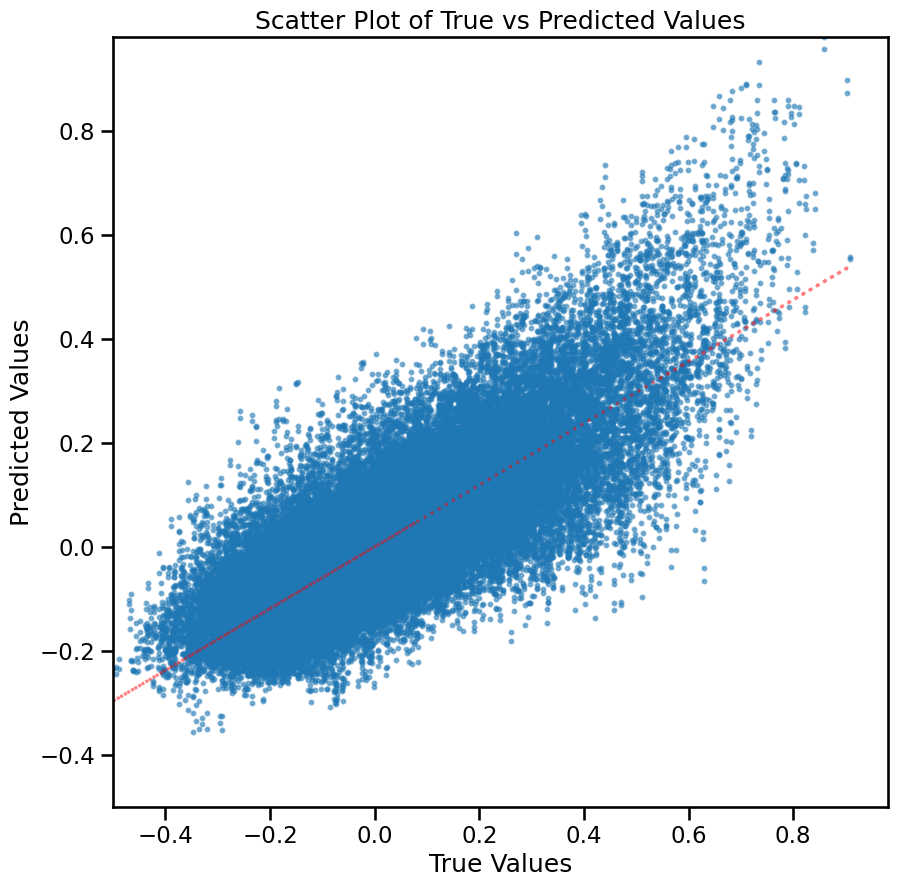

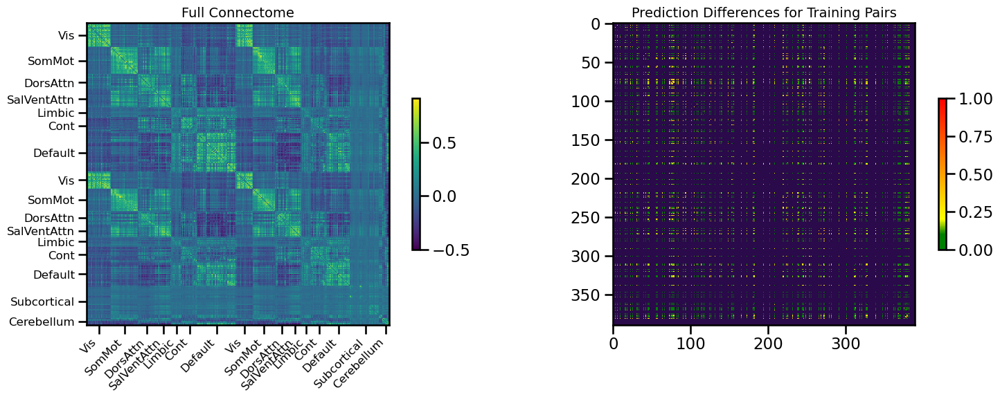

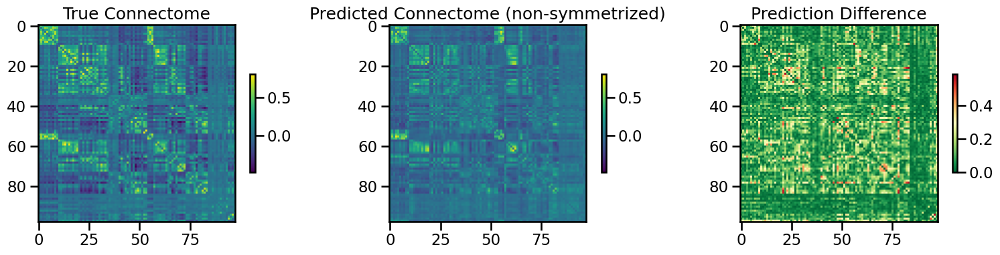

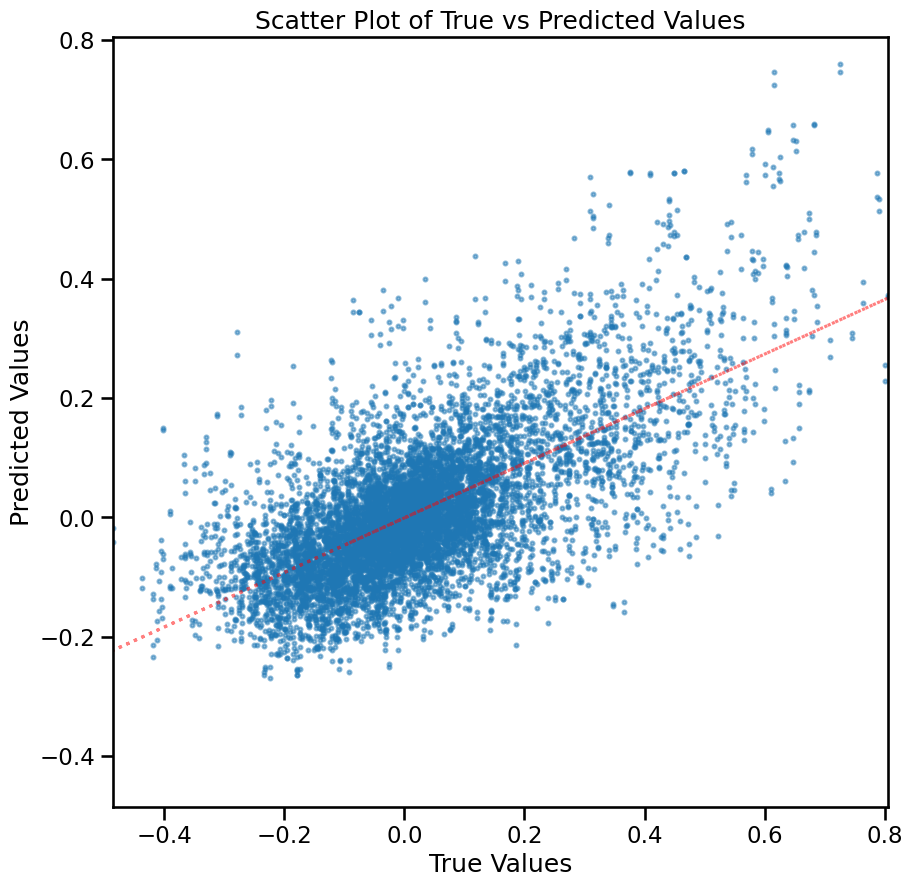

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.012418547, 'mae': 0.080161996, 'r2': 0.6261035756156093, 'pearson_corr': 0.7931896400858852, 'geodesic_distance': 19.371095353081238}
TEST METRICS: {'mse': 0.01708171, 'mae': 0.0946432, 'r2': 0.4370110268647067, 'pearson_corr': 0.6653673214047214, 'geodesic_distance': 12.597400979310192}
BEST VAL SCORE 0.02283706584651219
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.1, 'learning_rate': 9e-05, 'weight_decay': 1e-05, 'batch_size': 256, 'epochs': 100}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▄▄▄▄▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.02284
test_mse_loss,0.01738
train_mse_loss,0.01577


Final evaluation metrics logged successfully.
1
3
4
Create sweep with ID: vji47c56
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/vji47c56
sweep_id vji47c56


wandb: Agent Starting Run: bs1bzj1x with config:
wandb: 	batch_size: 64
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 100
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0335
Best val loss so far at epoch 2: 0.0275
Best val loss so far at epoch 3: 0.0262
Best val loss so far at epoch 4: 0.0257
Epoch 5/100, Train Loss: 0.0324, Val Loss: 0.0256
Best val loss so far at epoch 5: 0.0256
Best val loss so far at epoch 7: 0.0253
Best val loss so far at epoch 8: 0.0252
Epoch 10/100, Train Loss: 0.0285, Val Loss: 0.0248
Best val loss so far at epoch 10: 0.0248
Best val loss so far at epoch 11: 0.0246
Best val loss so far at epoch 12: 0.0241
Best val loss so far at epoch 13: 0.0239
Best val loss so far at epoch 14: 0.0236
Epoch 15/100, Train Loss: 0.0271, Val Loss: 0.0235
Best val loss so far at epoch 15: 0.0235
Best val loss so far at epoch 16: 0.0233
Best val loss so far at epoch 17: 0.0231
Best val loss so far at epoch 18: 0.0229
Best val loss so far at epoch 19: 0.0227
Epoch 20/100, Train Loss: 0.0262, Val 

fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇███
fold0_train_loss,█▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▄▄▄▄▃▃▃▃▂▂▂▂▂▁▂▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,72
fold0_train_loss,0.02277
fold0_val_loss,0.02057
inner_fold,0
mean_train_loss,0.02277


wandb: Agent Starting Run: p8dclxwe with config:
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 75
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0377
Best val loss so far at epoch 2: 0.0298
Best val loss so far at epoch 3: 0.0271
Best val loss so far at epoch 4: 0.0258


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Epoch 5/75, Train Loss: 0.0717, Val Loss: 0.0249
Best val loss so far at epoch 5: 0.0249
Best val loss so far at epoch 6: 0.0244
Best val loss so far at epoch 8: 0.0243
Best val loss so far at epoch 9: 0.0242
Epoch 10/75, Train Loss: 0.0351, Val Loss: 0.0243
Epoch 15/75, Train Loss: 0.0293, Val Loss: 0.0244
Best val loss so far at epoch 18: 0.0242
Best val loss so far at epoch 19: 0.0241
Epoch 20/75, Train Loss: 0.0280, Val Loss: 0.0240
Best val loss so far at epoch 20: 0.0240
Best val loss so far at epoch 21: 0.0238
Best val loss so far at epoch 22: 0.0236
Best val loss so far at epoch 23: 0.0235
Best val loss so far at epoch 24: 0.0234

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.023257
Epoch 25/75, Train Loss: 0.0271, Val Loss: 0.0233
Best val loss so far at epoch 25: 0.0233
Best val loss so far at epoch 26: 0.0232
Best val loss so far at epoch 27: 0.0231
Best val loss so far at epoch 28: 0.0231
Best val loss so far at epoch 29: 0.0231
Epoch 30/75, Train Loss: 0.0266, Val Loss: 0

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇████
fold0_train_loss,█▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,74
fold0_train_loss,0.02493
fold0_val_loss,0.02165
inner_fold,0
mean_train_loss,0.02493


wandb: Agent Starting Run: eb86qhh8 with config:
wandb: 	batch_size: 64
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 75
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 0.0001
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0315
Best val loss so far at epoch 2: 0.0273
Best val loss so far at epoch 3: 0.0245
Epoch 5/75, Train Loss: 0.0303, Val Loss: 0.0249
Best val loss so far at epoch 7: 0.0241
Best val loss so far at epoch 8: 0.0238
Best val loss so far at epoch 9: 0.0233
Epoch 10/75, Train Loss: 0.0270, Val Loss: 0.0231
Best val loss so far at epoch 10: 0.0231
Best val loss so far at epoch 11: 0.0224
Best val loss so far at epoch 12: 0.0223
Best val loss so far at epoch 13: 0.0220
Best val loss so far at epoch 14: 0.0217
Epoch 15/75, Train Loss: 0.0254, Val Loss: 0.0213
Best val loss so far at epoch 15: 0.0213
Best val loss so far at epoch 16: 0.0211
Best val loss so far at epoch 17: 0.0210
Best val loss so far at epoch 18: 0.0206
Epoch 20/75, Train Loss: 0.0239, Val Loss: 0.0205
Best val loss so far at epoch 20: 0.0205
Best val loss so far at epoch 

fold0_epoch,▁▁▁▁▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▅▅▆▆▆▆▇▇▇▇▇▇▇███
fold0_train_loss,█▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,███▇▇▆▅▅▄▄▄▂▃▃▃▂▂▂▃▂▃▂▂▃▂▂▂▁▂▂▁▁▂▁▁▁▂▁▁▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,74
fold0_train_loss,0.01978
fold0_val_loss,0.01922
inner_fold,0
mean_train_loss,0.01978


wandb: Agent Starting Run: rfy6qo1y with config:
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 75
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 0.0001
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0391


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 2: 0.0302
Best val loss so far at epoch 3: 0.0284
Best val loss so far at epoch 4: 0.0277
Epoch 5/75, Train Loss: 0.0703, Val Loss: 0.0266
Best val loss so far at epoch 5: 0.0266
Best val loss so far at epoch 6: 0.0260
Best val loss so far at epoch 7: 0.0256
Best val loss so far at epoch 9: 0.0256
Epoch 10/75, Train Loss: 0.0342, Val Loss: 0.0257
Epoch 15/75, Train Loss: 0.0294, Val Loss: 0.0256
Best val loss so far at epoch 15: 0.0256
Best val loss so far at epoch 17: 0.0255
Best val loss so far at epoch 18: 0.0254
Best val loss so far at epoch 19: 0.0252
Epoch 20/75, Train Loss: 0.0286, Val Loss: 0.0251
Best val loss so far at epoch 20: 0.0251
Best val loss so far at epoch 22: 0.0248
Best val loss so far at epoch 23: 0.0248
Best val loss so far at epoch 24: 0.0247
Epoch 25/75, Train Loss: 0.0277, Val Loss: 0.0244
Best val loss so far at epoch 25: 0.0244

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.024274
Best val loss so far at epoch 26: 0.0243
Epoch 

fold0_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇████
fold0_train_loss,█▄▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▄▄▄▄▄▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,74
fold0_train_loss,0.0261
fold0_val_loss,0.02289
inner_fold,0
mean_train_loss,0.0261


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 75, 'binarize': False, 'input_dim': 6, 'batch_size': 64, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.3, 'weight_decay': 0.0001, 'learning_rate': 0.0001}
Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0285
Best val loss so far at epoch 2: 0.0276
Best val loss so far at epoch 3: 0.0274
Best val loss so far at epoch 4: 0.0270
Epoch 5/75, Train Loss: 0.0264, Val Loss: 0.0263
Best val loss so far at epoch 5: 0.0263
Best val loss so far at epoch 6: 0.0261
Best val loss so far at epoch 7: 0.0251
Best val loss so far at epoch 8: 0.0247
Best val loss so far at epoch 9: 0.0247
Epoch 10/75, Train Loss: 0.0233, Val Loss: 0.0242
Best val loss so far at epoch 10: 0.0242
Best val loss so far at epoch 11: 0.0239
Best val loss so far at epoch 12: 0.0236
Best val loss so far at epoch 13: 0.0233
Epoch 15/75, Train Loss: 0.0219, Val Loss: 0.0235
Best val loss so far at 

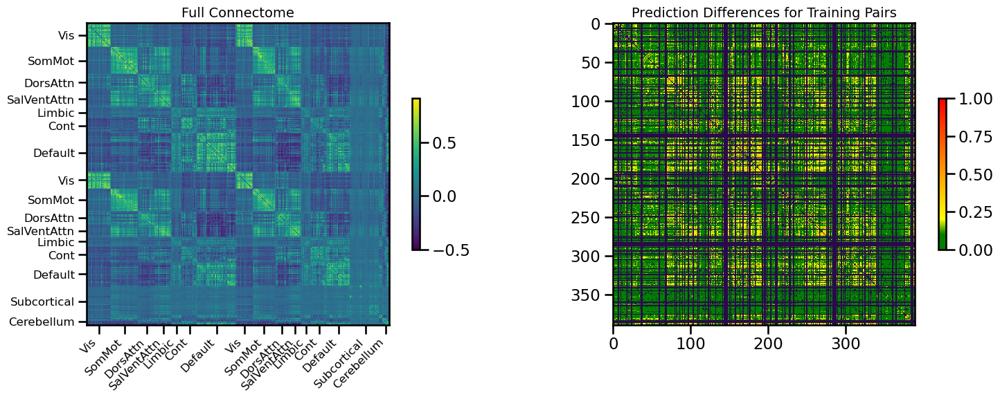

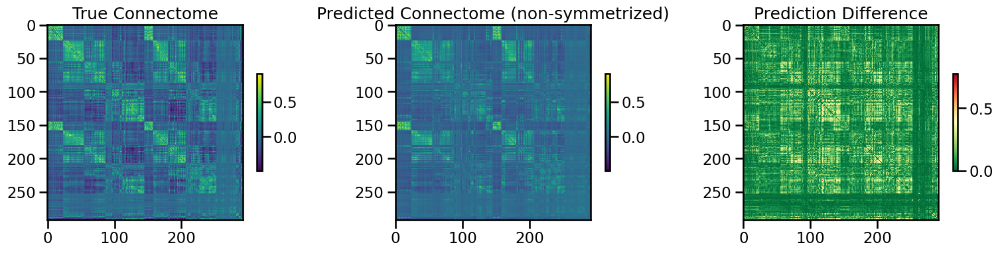

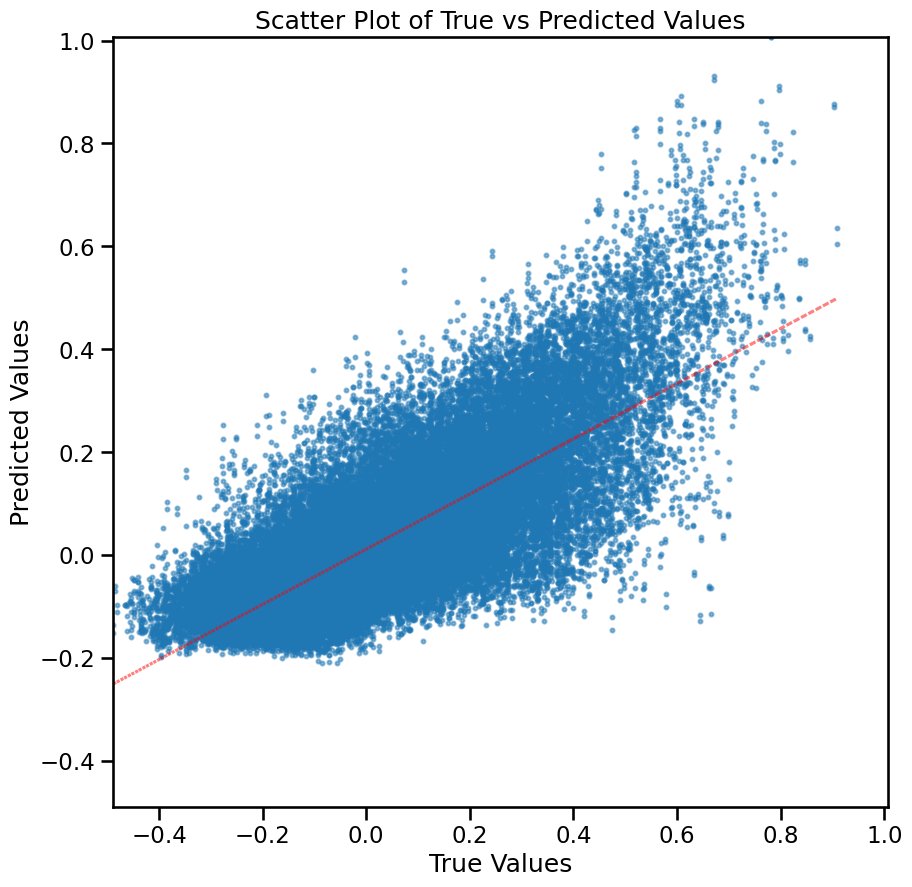

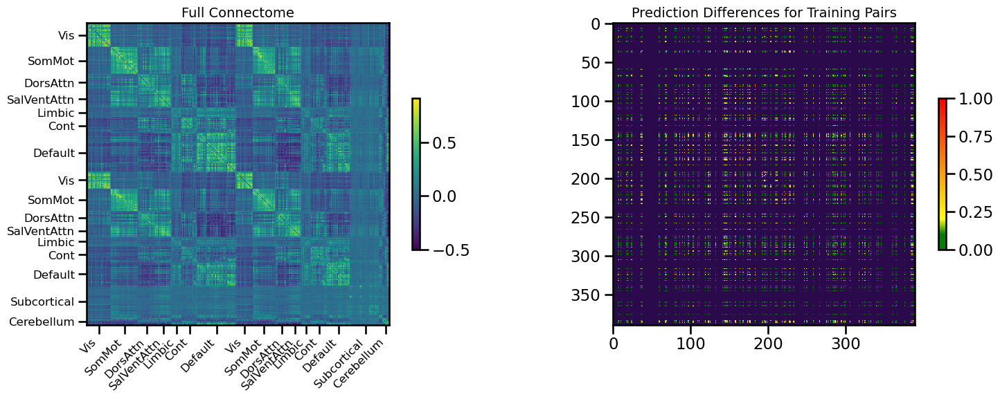

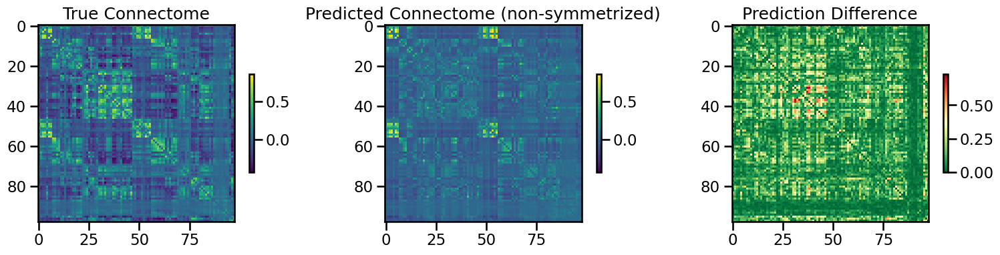

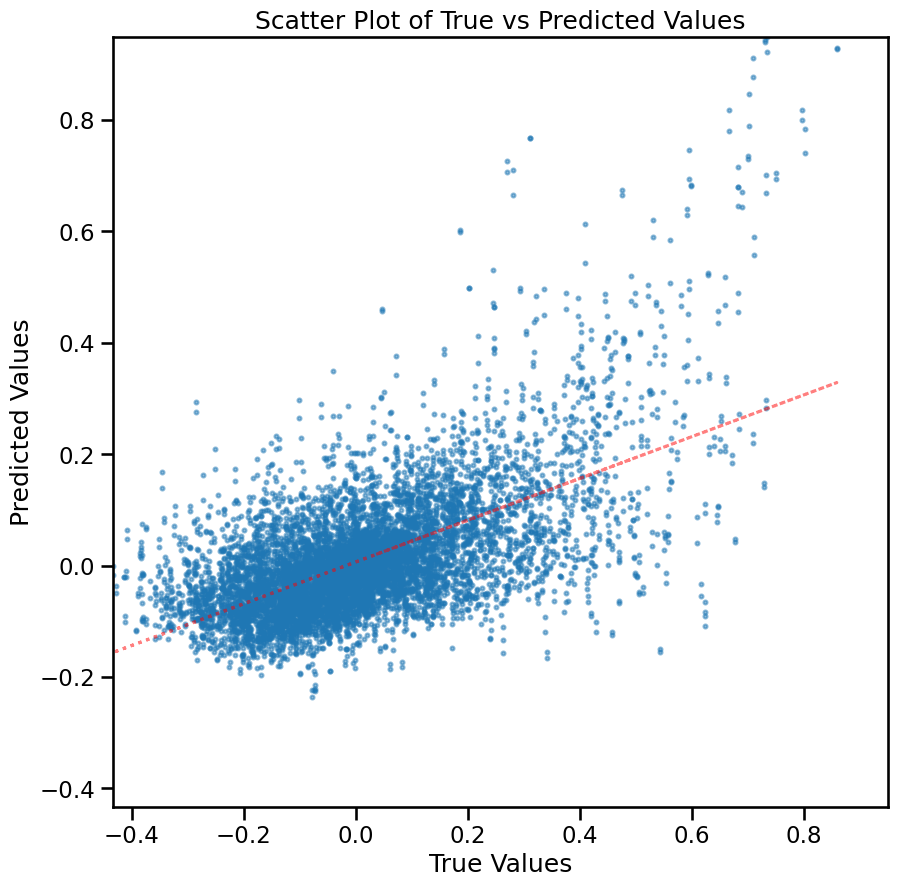

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.013826025, 'mae': 0.08467598, 'r2': 0.5802695267065126, 'pearson_corr': 0.7645429300740461, 'geodesic_distance': 18.56344060536104}
TEST METRICS: {'mse': 0.019821422, 'mae': 0.1019083, 'r2': 0.37562759178912175, 'pearson_corr': 0.6128851339222933, 'geodesic_distance': 12.408518567930727}
BEST VAL SCORE 0.01922121499477567
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.3, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 64, 'epochs': 75}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▇▇▅▄▄▄▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▂▂▁▂▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.01922
test_mse_loss,0.01984
train_mse_loss,0.01785


Final evaluation metrics logged successfully.
1
2
4
Create sweep with ID: hi3cml99
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/hi3cml99
sweep_id hi3cml99


wandb: Agent Starting Run: f7fh144d with config:
wandb: 	batch_size: 64
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 75
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0299
Best val loss so far at epoch 2: 0.0276
Best val loss so far at epoch 3: 0.0265
Best val loss so far at epoch 4: 0.0253
Epoch 5/75, Train Loss: 0.0340, Val Loss: 0.0250
Best val loss so far at epoch 5: 0.0250
Best val loss so far at epoch 6: 0.0250
Best val loss so far at epoch 7: 0.0249
Best val loss so far at epoch 8: 0.0245
Best val loss so far at epoch 9: 0.0243
Epoch 10/75, Train Loss: 0.0273, Val Loss: 0.0243
Best val loss so far at epoch 10: 0.0243
Best val loss so far at epoch 12: 0.0241
Best val loss so far at epoch 13: 0.0240
Best val loss so far at epoch 14: 0.0239
Epoch 15/75, Train Loss: 0.0259, Val Loss: 0.0239
Best val loss so far at epoch 18: 0.0228
Epoch 20/75, Train Loss: 0.0247, Val Loss: 0.0231
Best val loss so far at epoch 22: 0.0225
Best val loss so far at epoch 24: 0.0225
Epoch 25/7

fold0_epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▃▃▃▃▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇██
fold0_train_loss,█▅▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▇▆▅▅▅▅▄▄▅▄▃▂▂▃▂▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▂▁▁▁▁▁▁▂▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,74
fold0_train_loss,0.02117
fold0_val_loss,0.02118
inner_fold,0
mean_train_loss,0.02117


wandb: Agent Starting Run: eu82kpsx with config:
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 100
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 0.0001
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0291
Best val loss so far at epoch 2: 0.0259
Best val loss so far at epoch 3: 0.0249
Best val loss so far at epoch 4: 0.0242
Epoch 5/100, Train Loss: 0.0387, Val Loss: 0.0238
Best val loss so far at epoch 5: 0.0238
Best val loss so far at epoch 6: 0.0237
Best val loss so far at epoch 7: 0.0234


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 8: 0.0233
Best val loss so far at epoch 9: 0.0232
Epoch 10/100, Train Loss: 0.0283, Val Loss: 0.0231
Best val loss so far at epoch 10: 0.0231
Best val loss so far at epoch 11: 0.0229
Best val loss so far at epoch 13: 0.0226
Epoch 15/100, Train Loss: 0.0251, Val Loss: 0.0224
Best val loss so far at epoch 15: 0.0224
Best val loss so far at epoch 16: 0.0223
Best val loss so far at epoch 18: 0.0220
Epoch 20/100, Train Loss: 0.0233, Val Loss: 0.0218
Best val loss so far at epoch 20: 0.0218
Best val loss so far at epoch 21: 0.0218
Best val loss so far at epoch 23: 0.0214
Epoch 25/100, Train Loss: 0.0221, Val Loss: 0.0214
Best val loss so far at epoch 27: 0.0214
Best val loss so far at epoch 28: 0.0213

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.021338
Epoch 30/100, Train Loss: 0.0211, Val Loss: 0.0211
Best val loss so far at epoch 30: 0.0211
Best val loss so far at epoch 31: 0.0211
Best val loss so far at epoch 33: 0.0209
Best val loss so far at epoch 34: 0.

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
fold0_train_loss,█▅▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▇▇▆▆▆▅▅▄▄▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▂▁▁▁▁▂▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,69
fold0_train_loss,0.01902
fold0_val_loss,0.02061
inner_fold,0
mean_train_loss,0.01902


wandb: Agent Starting Run: 23rjgjuu with config:
wandb: 	batch_size: 64
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 75
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 0.0001
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



  warnings.warn(



Processing inner fold 0
Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0274
Best val loss so far at epoch 2: 0.0250
Best val loss so far at epoch 3: 0.0241
Epoch 5/75, Train Loss: 0.0218, Val Loss: 0.0232
Best val loss so far at epoch 5: 0.0232
Best val loss so far at epoch 6: 0.0232
Best val loss so far at epoch 8: 0.0223
Epoch 10/75, Train Loss: 0.0191, Val Loss: 0.0219
Best val loss so far at epoch 10: 0.0219
Epoch 15/75, Train Loss: 0.0174, Val Loss: 0.0216
Best val loss so far at epoch 15: 0.0216
Best val loss so far at epoch 16: 0.0209
Epoch 20/75, Train Loss: 0.0165, Val Loss: 0.0207
Best val loss so far at epoch 20: 0.0207
Best val loss so far at epoch 22: 0.0205
Best val loss so far at epoch 23: 0.0199
Epoch 25/75, Train Loss: 0.0154, Val Loss: 0.0205
Epoch 30/75, Train Loss: 0.0146, Val Loss: 0.0193
Best val loss so far at epoch 30: 0.0193
Epoch 35/75, Train Loss: 0.01

In [ ]:
# Run simulation
single_sim_run(
              cv_type='random',
              random_seed=42,
              model_type='dynamic_mlp',
              feature_type=[{'euclidean': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              impute_strategy=None,
              sort_genes='expression', 
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 4),
              save_sim=False,
              track_wandb=True,
              skip_cv=False
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

In [ ]:
# Run simulation
single_sim_run(
              cv_type='random',
              random_seed=42,
              model_type='dynamic_mlp',
              feature_type=[{'transcriptome': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              impute_strategy=None,
              sort_genes='expression',
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 4),
              save_sim=False,
              track_wandb=True,
              skip_cv=False
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

In [ ]:
# Run simulation
single_sim_run(
              cv_type='random',
              random_seed=42,
              model_type='shared_transformer',
              feature_type=[{'transcriptome': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              impute_strategy=None,
              sort_genes='expression',
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 4),
              save_sim=False,
              track_wandb=True,
              skip_cv=False
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

In [ ]:
# Run simulation
single_sim_run(
              cv_type='random',
              random_seed=42,
              model_type='shared_transformer_cls',
              feature_type=[{'transcriptome': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              impute_strategy=None,
              sort_genes='expression', 
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 4),
              save_sim=False,
              track_wandb=True,
              skip_cv=False
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Spatial

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
Network coverage: 100.0% of regions
Network sizes: [113, 113, 113, 116]
feature_name:  euclidean
processing_type:  None
features ['euclidean']
X generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin


2
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: bdowheow
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/bdowheow
sweep_id bdowheow


wandb: Agent Starting Run: 0d3foa72 with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 75
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.00 GB
Best val loss so far at epoch 1: 0.1073
Best val loss so far at epoch 2: 0.0826


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 4: 0.0662
Epoch 5/75, Train Loss: 0.0204, Val Loss: 0.0620
Best val loss so far at epoch 5: 0.0620
Epoch 10/75, Train Loss: 0.0165, Val Loss: 0.0608
Best val loss so far at epoch 10: 0.0608
Best val loss so far at epoch 11: 0.0530
Epoch 15/75, Train Loss: 0.0141, Val Loss: 0.0652
Epoch 20/75, Train Loss: 0.0131, Val Loss: 0.0712
Epoch 25/75, Train Loss: 0.0118, Val Loss: 0.0711
Epoch 30/75, Train Loss: 0.0110, Val Loss: 0.0726

Early stopping triggered at epoch 31. Restoring best model with Val Loss: 0.0530


  from IPython.core.display import HTML, display  # type: ignore



fold0_epoch,▁▁▁▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▇▇▇▇███
fold0_train_loss,█▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▅▃▂▂▃▂▃▂▁▁▂▃▃▂▂▃▄▃▃▂▃▃▃▂▁▃▃▄▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,30
fold0_train_loss,0.01075
fold0_val_loss,0.05666
inner_fold,0
mean_train_loss,0.01075


wandb: Agent Starting Run: gyj3cw2l with config:
wandb: 	batch_size: 64
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 75
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0644
Best val loss so far at epoch 2: 0.0476
Best val loss so far at epoch 3: 0.0476
Best val loss so far at epoch 4: 0.0443
Epoch 5/75, Train Loss: 0.0312, Val Loss: 0.0454
Best val loss so far at epoch 6: 0.0433
Best val loss so far at epoch 8: 0.0416
Best val loss so far at epoch 9: 0.0416
Epoch 10/75, Train Loss: 0.0254, Val Loss: 0.0426
Best val loss so far at epoch 12: 0.0404
Epoch 15/75, Train Loss: 0.0231, Val Loss: 0.0408
Epoch 20/75, Train Loss: 0.0213, Val Loss: 0.0395
Best val loss so far at epoch 20: 0.0395
Epoch 25/75, Train Loss: 0.0200, Val Loss: 0.0413

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.042654
Epoch 30/75, Train Loss: 0.0184, Val Loss: 0.0403
Epoch 35/75, Train Loss: 0.0179, Val Loss: 0.0423
Best val loss so far at epoch 38: 0.0394
Epoch 40/75, Train Loss: 0.0175, Val Loss: 0.0423
Best val loss so far a

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▂▂▂▃▃▃▃▄▄▄▄▄▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇██
fold0_train_loss,█▄▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▅▅▄▄▃▃▃▃█▂▃▂▄▅▆▄▃▂▄▃▄▁▃▁▂▂▂▁▂▂▂▂▂▂▂▂▁▂▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,66
fold0_train_loss,0.01628
fold0_val_loss,0.03974
inner_fold,0
mean_train_loss,0.01628


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: 3atsek90 with config:
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 100
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0721
Best val loss so far at epoch 2: 0.0614
Best val loss so far at epoch 3: 0.0550


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Epoch 5/100, Train Loss: 0.0265, Val Loss: 0.0523
Best val loss so far at epoch 5: 0.0523
Best val loss so far at epoch 7: 0.0516
Best val loss so far at epoch 9: 0.0513
Epoch 10/100, Train Loss: 0.0228, Val Loss: 0.0514
Best val loss so far at epoch 11: 0.0513
Best val loss so far at epoch 12: 0.0484
Epoch 15/100, Train Loss: 0.0210, Val Loss: 0.0510
Epoch 20/100, Train Loss: 0.0197, Val Loss: 0.0489
Epoch 25/100, Train Loss: 0.0184, Val Loss: 0.0524
Epoch 30/100, Train Loss: 0.0178, Val Loss: 0.0568

Early stopping triggered at epoch 32. Restoring best model with Val Loss: 0.0484


fold0_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▆▇▇▇▇███
fold0_train_loss,█▄▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▃▄▂▃▂▂▂▂▂▁▂▂▂▃▄▂▂▁▂▂▁▄▂▂▂▂▃▃▃▃
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,31
fold0_train_loss,0.01749
fold0_val_loss,0.05615
inner_fold,0
mean_train_loss,0.01749


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 75, 'binarize': False, 'input_dim': 6, 'batch_size': 64, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.1, 'weight_decay': 1e-05, 'learning_rate': 9e-05}
Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0291
Best val loss so far at epoch 2: 0.0238
Best val loss so far at epoch 3: 0.0231
Best val loss so far at epoch 4: 0.0230
Epoch 5/75, Train Loss: 0.0256, Val Loss: 0.0225
Best val loss so far at epoch 5: 0.0225
Best val loss so far at epoch 6: 0.0221
Best val loss so far at epoch 8: 0.0220
Best val loss so far at epoch 9: 0.0220
Epoch 10/75, Train Loss: 0.0220, Val Loss: 0.0226
Epoch 15/75, Train Loss: 0.0201, Val Loss: 0.0239
Epoch 20/75, Train Loss: 0.0189, Val Loss: 0.0237

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.026201
Epoch 25/75, Train Loss: 0.0174, Val Loss: 0.0245

Early stopping triggered at epoch 29. Restoring best model with Val Loss: 

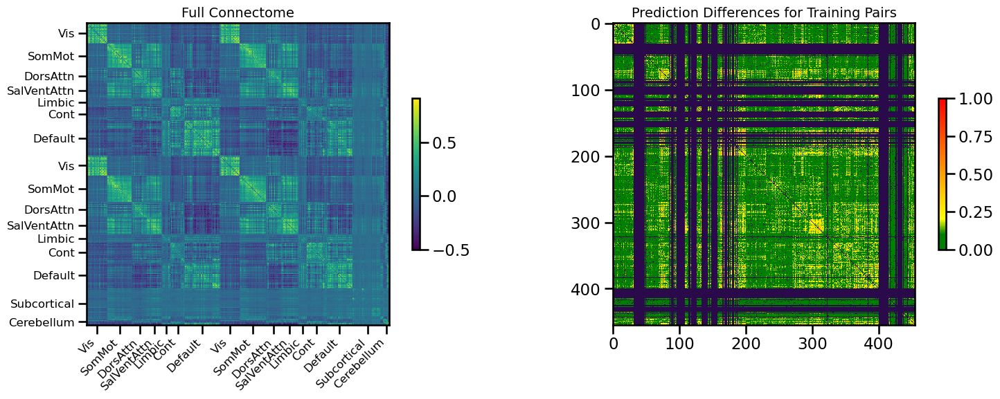

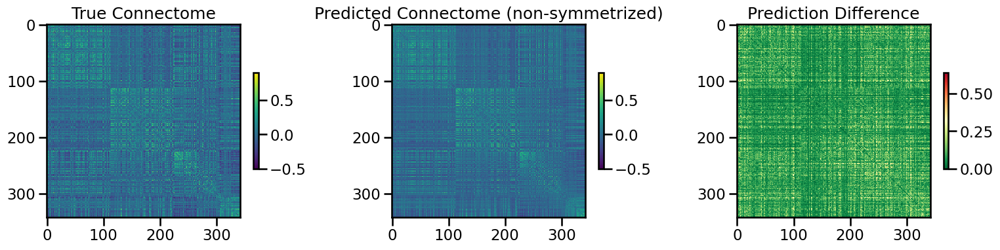

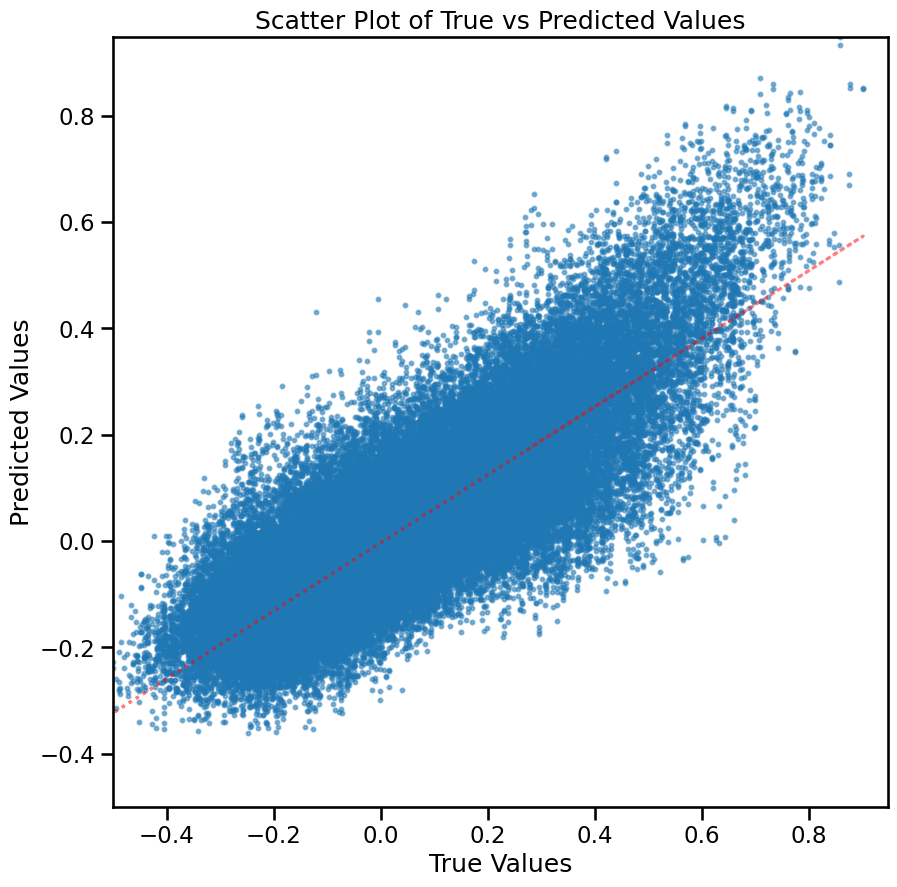

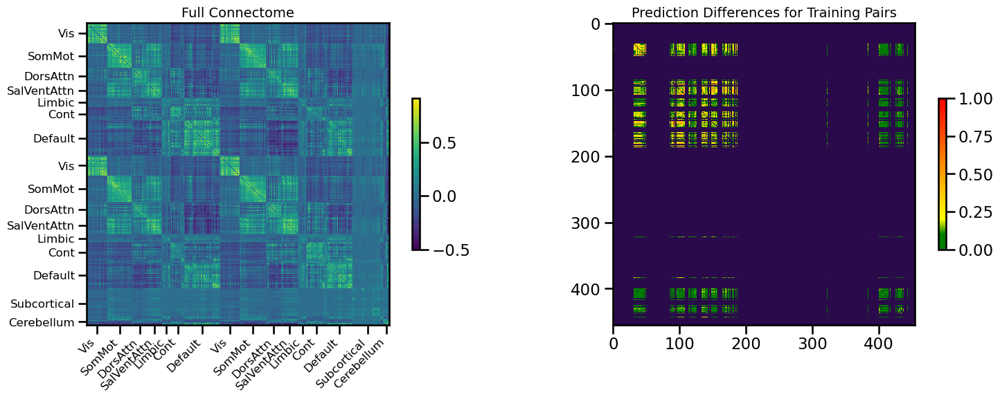

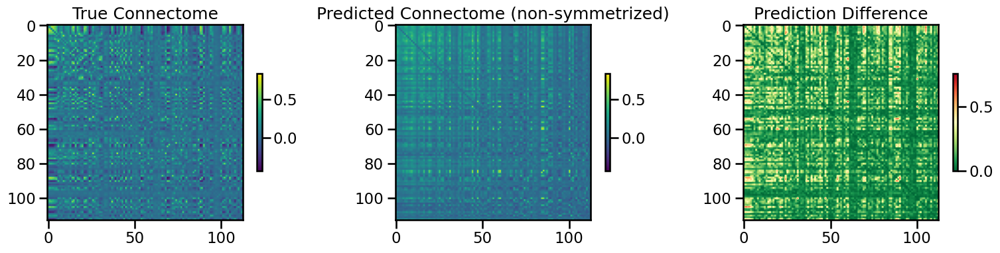

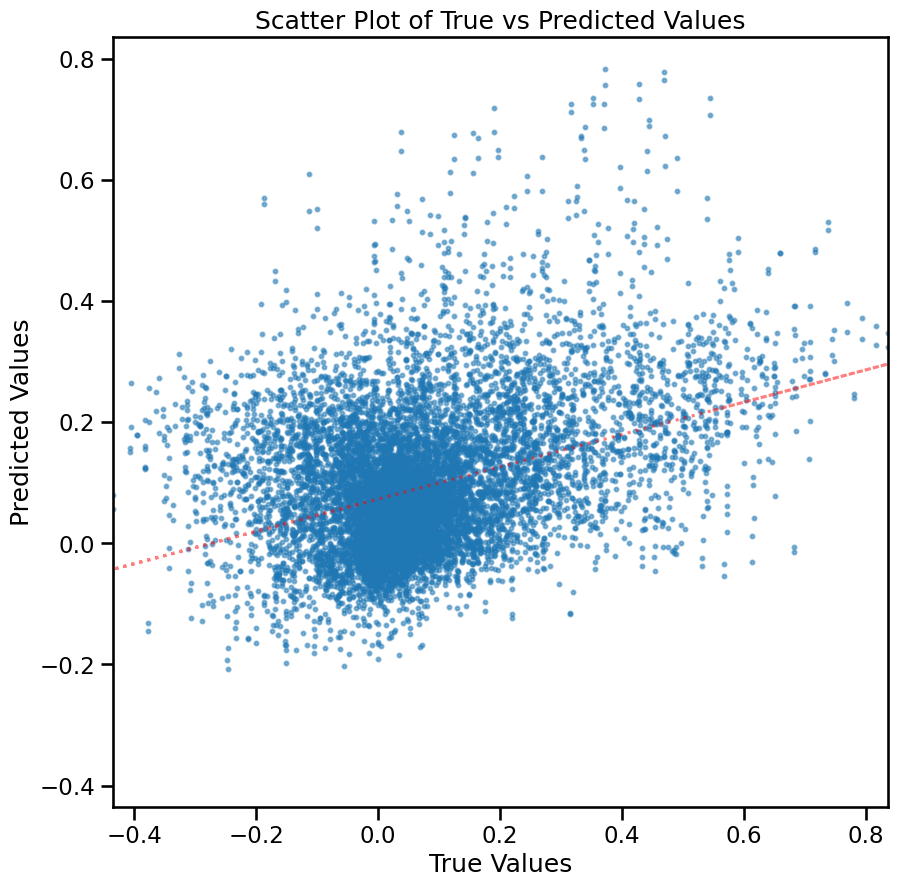

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.012680016, 'mae': 0.08346607, 'r2': 0.6778979260902714, 'pearson_corr': 0.8263207536950999, 'geodesic_distance': 18.444835208065495}
TEST METRICS: {'mse': 0.025816651, 'mae': 0.11325081, 'r2': -0.02262527054926311, 'pearson_corr': 0.3654868813407425, 'geodesic_distance': 13.284567076665102}
BEST VAL SCORE 0.03974340150057517
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.1, 'learning_rate': 9e-05, 'weight_decay': 1e-05, 'batch_size': 64, 'epochs': 75}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▃▂▂▁▁▂▁▁▂▁▂▁▂▃▁▃▂▂▃▂▃▅▆▃█▅▇▅
train_mse_loss,█▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.03974
test_mse_loss,0.0258
train_mse_loss,0.01709


Final evaluation metrics logged successfully.
1
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: bh1b1pbl
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/bh1b1pbl
sweep_id bh1b1pbl


wandb: Agent Starting Run: s7xbnass with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 100
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 0.0001
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.1166
Best val loss so far at epoch 2: 0.0640
Best val loss so far at epoch 3: 0.0618


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 4: 0.0533
Epoch 5/100, Train Loss: 0.0293, Val Loss: 0.0523
Best val loss so far at epoch 5: 0.0523
Best val loss so far at epoch 6: 0.0473
Best val loss so far at epoch 8: 0.0446
Epoch 10/100, Train Loss: 0.0250, Val Loss: 0.0492
Best val loss so far at epoch 11: 0.0410
Epoch 15/100, Train Loss: 0.0224, Val Loss: 0.0378
Best val loss so far at epoch 15: 0.0378
Epoch 20/100, Train Loss: 0.0208, Val Loss: 0.0439
Epoch 25/100, Train Loss: 0.0194, Val Loss: 0.0479
Epoch 30/100, Train Loss: 0.0184, Val Loss: 0.0432

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.051356
Epoch 35/100, Train Loss: 0.0172, Val Loss: 0.0476

Early stopping triggered at epoch 35. Restoring best model with Val Loss: 0.0378


fold0_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇███
fold0_train_loss,█▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▃▃▂▂▂▂▂▂▂▁▂▁▂▁▁▁▂▁▂▂▁▁▂▂▁▁▂▂▁▂▂▁▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,34
fold0_train_loss,0.01716
fold0_val_loss,0.04763
inner_fold,0
mean_train_loss,0.01716


wandb: Agent Starting Run: pe7vvqv8 with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 75
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0819


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 2: 0.0683
Best val loss so far at epoch 3: 0.0598
Epoch 5/75, Train Loss: 0.0208, Val Loss: 0.0580
Best val loss so far at epoch 5: 0.0580
Epoch 10/75, Train Loss: 0.0165, Val Loss: 0.0772
Epoch 15/75, Train Loss: 0.0143, Val Loss: 0.0631
Epoch 20/75, Train Loss: 0.0130, Val Loss: 0.0589
Best val loss so far at epoch 23: 0.0565

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.066670
Epoch 25/75, Train Loss: 0.0110, Val Loss: 0.0569
Epoch 30/75, Train Loss: 0.0104, Val Loss: 0.0605
Epoch 35/75, Train Loss: 0.0101, Val Loss: 0.0659
Epoch 40/75, Train Loss: 0.0098, Val Loss: 0.0639

Early stopping triggered at epoch 43. Restoring best model with Val Loss: 0.0565


fold0_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇██
fold0_train_loss,█▄▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▄▂▄▁▄▃▃▃▆▄█▅▃▅▅▂▃▂▂▄▁▄▁▂▂▁▂▃▂▂▂▃▃▂▃▄▃▃▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,42
fold0_train_loss,0.00976
fold0_val_loss,0.06176
inner_fold,0
mean_train_loss,0.00976


wandb: Agent Starting Run: rrr6pjly with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 100
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 0.0001
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0420
Best val loss so far at epoch 2: 0.0349
Best val loss so far at epoch 3: 0.0341
Best val loss so far at epoch 4: 0.0304
Epoch 5/100, Train Loss: 0.0800, Val Loss: 0.0308


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 6: 0.0286
Best val loss so far at epoch 7: 0.0262
Best val loss so far at epoch 8: 0.0260
Best val loss so far at epoch 9: 0.0251
Epoch 10/100, Train Loss: 0.0436, Val Loss: 0.0245
Best val loss so far at epoch 10: 0.0245
Best val loss so far at epoch 11: 0.0241
Epoch 15/100, Train Loss: 0.0349, Val Loss: 0.0245
Epoch 20/100, Train Loss: 0.0324, Val Loss: 0.0241
Best val loss so far at epoch 21: 0.0240
Best val loss so far at epoch 22: 0.0238
Best val loss so far at epoch 23: 0.0238
Best val loss so far at epoch 24: 0.0237
Epoch 25/100, Train Loss: 0.0311, Val Loss: 0.0232
Best val loss so far at epoch 25: 0.0232
Best val loss so far at epoch 26: 0.0231
Best val loss so far at epoch 27: 0.0230
Best val loss so far at epoch 28: 0.0226
Epoch 30/100, Train Loss: 0.0300, Val Loss: 0.0225
Best val loss so far at epoch 30: 0.0225
Best val loss so far at epoch 31: 0.0223
Best val loss so far at epoch 32: 0.0222
Best val loss so far at epoch 33: 0.0221
Best val lo

fold0_epoch,▁▁▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇▇██
fold0_train_loss,█▅▄▄▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▄▃▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,76
fold0_train_loss,0.02659
fold0_val_loss,0.02172
inner_fold,0
mean_train_loss,0.02659


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 100, 'binarize': False, 'input_dim': 6, 'batch_size': 512, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.3, 'weight_decay': 0, 'learning_rate': 0.0001}
Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0503
Best val loss so far at epoch 2: 0.0468
Best val loss so far at epoch 3: 0.0463
Epoch 5/100, Train Loss: 0.0394, Val Loss: 0.0483
Epoch 10/100, Train Loss: 0.0271, Val Loss: 0.0498
Epoch 15/100, Train Loss: 0.0255, Val Loss: 0.0458
Best val loss so far at epoch 15: 0.0458
Best val loss so far at epoch 16: 0.0449
Best val loss so far at epoch 17: 0.0443
Best val loss so far at epoch 18: 0.0438
Best val loss so far at epoch 19: 0.0435
Epoch 20/100, Train Loss: 0.0242, Val Loss: 0.0429
Best val loss so far at epoch 20: 0.0429
Best val loss so far at epoch 21: 0.0420
Best val loss so far at epoch 22: 0.0414
Best val loss so far at epoch 23: 0.0407
Best val

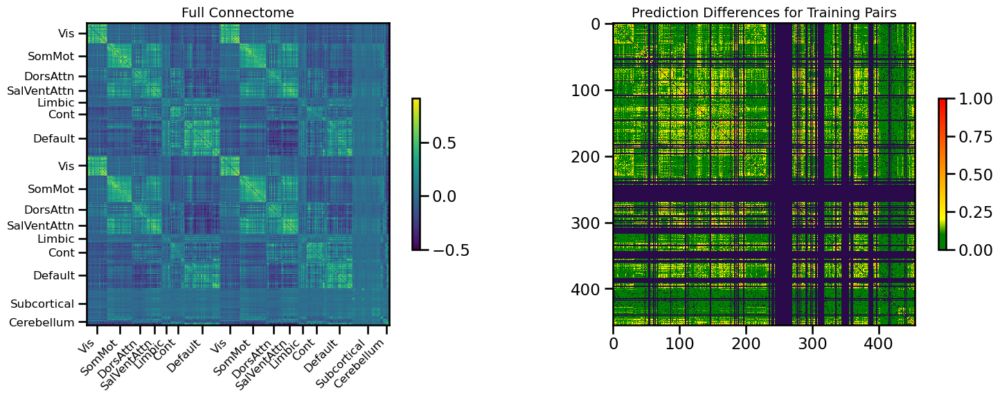

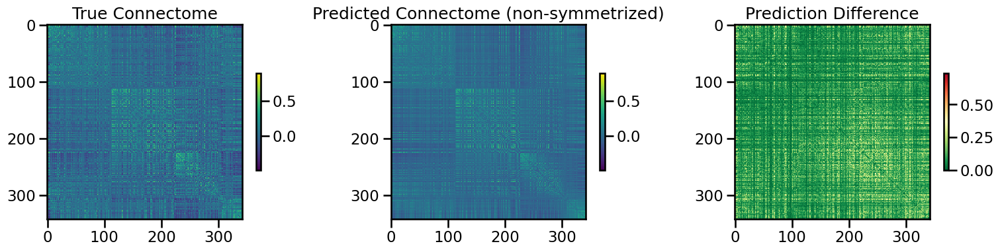

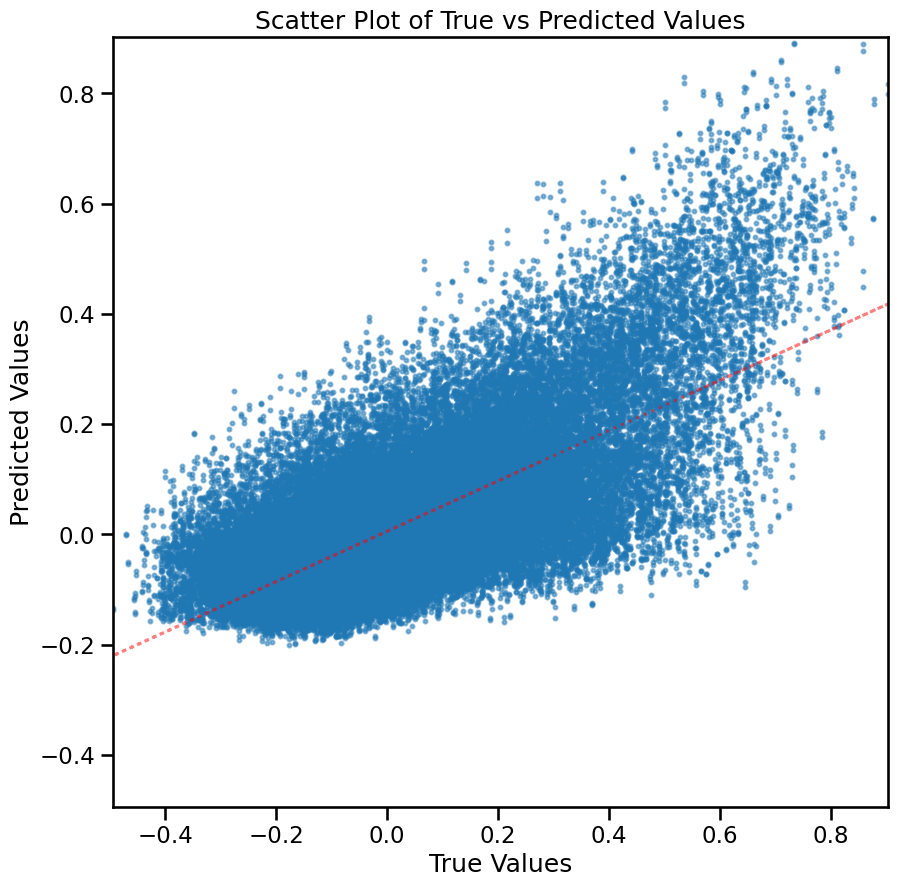

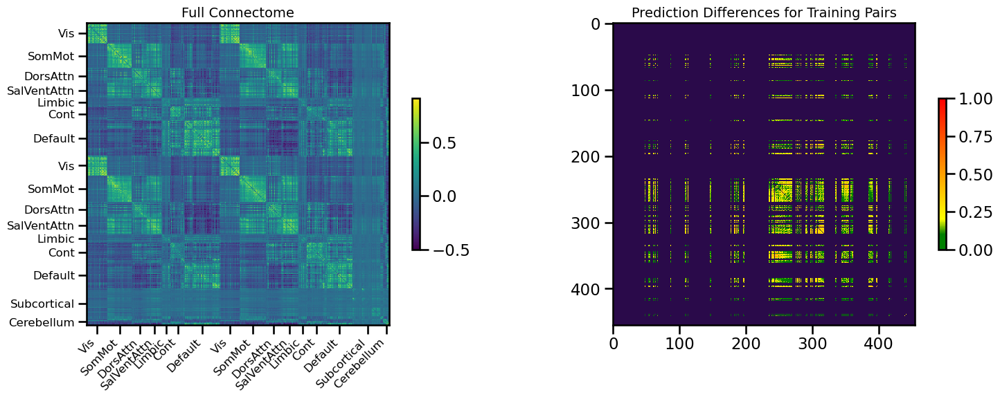

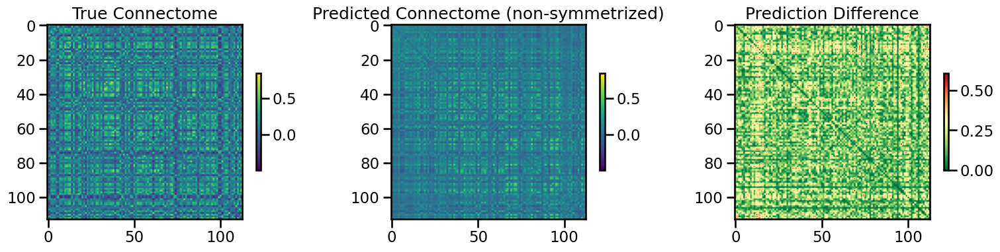

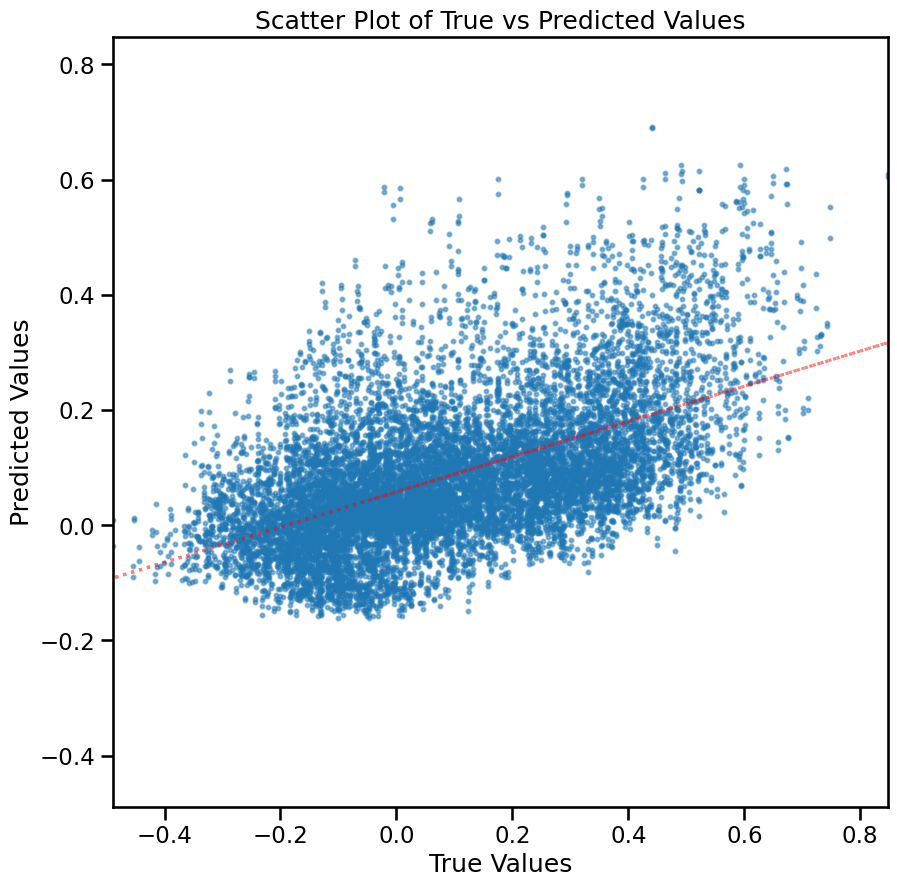

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.016316598, 'mae': 0.090735905, 'r2': 0.49519215740555567, 'pearson_corr': 0.7062854676541295, 'geodesic_distance': 22.160416921173194}
TEST METRICS: {'mse': 0.03603852, 'mae': 0.15438838, 'r2': 0.29527175963348085, 'pearson_corr': 0.5444441786085312, 'geodesic_distance': 11.718199768060709}
BEST VAL SCORE 0.021718909181654453
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.3, 'learning_rate': 0.0001, 'weight_decay': 0, 'batch_size': 512, 'epochs': 100}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▆▇▇▇█▇▇▆▅▄▄▃▃▃▂▂▂▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.02172
test_mse_loss,0.03605
train_mse_loss,0.01928


Final evaluation metrics logged successfully.
1
2
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: wef3hp96
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/wef3hp96
sweep_id wef3hp96


wandb: Agent Starting Run: szv2jh1p with config:
wandb: 	batch_size: 64
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 75
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0382
Best val loss so far at epoch 2: 0.0297
Best val loss so far at epoch 3: 0.0263
Best val loss so far at epoch 4: 0.0248
Epoch 5/75, Train Loss: 0.0348, Val Loss: 0.0258
Best val loss so far at epoch 6: 0.0236
Epoch 10/75, Train Loss: 0.0305, Val Loss: 0.0254
Best val loss so far at epoch 12: 0.0228
Epoch 15/75, Train Loss: 0.0284, Val Loss: 0.0251
Best val loss so far at epoch 17: 0.0227
Epoch 20/75, Train Loss: 0.0272, Val Loss: 0.0235
Epoch 25/75, Train Loss: 0.0261, Val Loss: 0.0268

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.022396
Best val loss so far at epoch 27: 0.0224
Epoch 30/75, Train Loss: 0.0255, Val Loss: 0.0243
Epoch 35/75, Train Loss: 0.0249, Val Loss: 0.0257
Epoch 40/75, Train Loss: 0.0249, Val Loss: 0.0251
Epoch 45/75, Train Loss: 0.0246, Val Loss: 0.0250

Early stopping triggered at epoch 47. Restoring best

fold0_epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
fold0_train_loss,█▄▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▄▃▂▂▁▂▂▂▂▁▂▂▁▁▁▁▂▁▂▂▃▁▁▁▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,46
fold0_train_loss,0.02443
fold0_val_loss,0.02438
inner_fold,0
mean_train_loss,0.02443


wandb: Agent Starting Run: wjvnqez4 with config:
wandb: 	batch_size: 64
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 75
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0293
Best val loss so far at epoch 2: 0.0261
Best val loss so far at epoch 3: 0.0239
Best val loss so far at epoch 4: 0.0236
Epoch 5/75, Train Loss: 0.0332, Val Loss: 0.0246
Best val loss so far at epoch 6: 0.0228
Epoch 10/75, Train Loss: 0.0269, Val Loss: 0.0224
Best val loss so far at epoch 10: 0.0224
Best val loss so far at epoch 11: 0.0219
Best val loss so far at epoch 12: 0.0217
Best val loss so far at epoch 13: 0.0213
Epoch 15/75, Train Loss: 0.0242, Val Loss: 0.0218
Epoch 20/75, Train Loss: 0.0225, Val Loss: 0.0223
Epoch 25/75, Train Loss: 0.0212, Val Loss: 0.0247

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.023328
Epoch 30/75, Train Loss: 0.0198, Val Loss: 0.0239

Early stopping triggered at epoch 33. Restoring best model with Val Loss: 0.0213


fold0_epoch,▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇███
fold0_train_loss,█▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▃▃▄▂▂▃▃▂▂▁▁▂▁▂▃▂▂▂▆▄▂▅▄▃▃▄▃▃▃▃▄
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,32
fold0_train_loss,0.01938
fold0_val_loss,0.02427
inner_fold,0
mean_train_loss,0.01938


wandb: Agent Starting Run: bxg5fg97 with config:
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 75
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 0.0001
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0558


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 2: 0.0381
Best val loss so far at epoch 3: 0.0310
Best val loss so far at epoch 4: 0.0293
Epoch 5/75, Train Loss: 0.0591, Val Loss: 0.0271
Best val loss so far at epoch 5: 0.0271
Best val loss so far at epoch 6: 0.0253
Best val loss so far at epoch 7: 0.0250
Best val loss so far at epoch 8: 0.0245
Best val loss so far at epoch 9: 0.0244
Epoch 10/75, Train Loss: 0.0377, Val Loss: 0.0246
Best val loss so far at epoch 13: 0.0244
Epoch 15/75, Train Loss: 0.0359, Val Loss: 0.0247
Best val loss so far at epoch 16: 0.0241
Epoch 20/75, Train Loss: 0.0348, Val Loss: 0.0237
Best val loss so far at epoch 20: 0.0237
Epoch 25/75, Train Loss: 0.0338, Val Loss: 0.0236
Best val loss so far at epoch 25: 0.0236
Best val loss so far at epoch 28: 0.0233
Best val loss so far at epoch 29: 0.0231
Epoch 30/75, Train Loss: 0.0327, Val Loss: 0.0225
Best val loss so far at epoch 30: 0.0225
Best val loss so far at epoch 31: 0.0224
Epoch 35/75, Train Loss: 0.0317, Val Loss: 0.0221
Bes

fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇████
fold0_train_loss,█▃▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▄▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,74
fold0_train_loss,0.02981
fold0_val_loss,0.02112
inner_fold,0
mean_train_loss,0.02981


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 75, 'binarize': False, 'input_dim': 6, 'batch_size': 256, 'hidden_dims': [256, 128], 'dropout_rate': 0.3, 'weight_decay': 0, 'learning_rate': 0.0001}
Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0567
Best val loss so far at epoch 2: 0.0549
Best val loss so far at epoch 3: 0.0545
Best val loss so far at epoch 4: 0.0545
Epoch 5/75, Train Loss: 0.0315, Val Loss: 0.0554
Best val loss so far at epoch 6: 0.0530
Best val loss so far at epoch 8: 0.0527
Best val loss so far at epoch 9: 0.0505
Epoch 10/75, Train Loss: 0.0295, Val Loss: 0.0497
Best val loss so far at epoch 10: 0.0497
Best val loss so far at epoch 11: 0.0477
Best val loss so far at epoch 12: 0.0472
Best val loss so far at epoch 13: 0.0465
Best val loss so far at epoch 14: 0.0449
Epoch 15/75, Train Loss: 0.0280, Val Loss: 0.0447
Best val loss so far at epoch 15: 0.0447
Best val loss so far at epoch 16

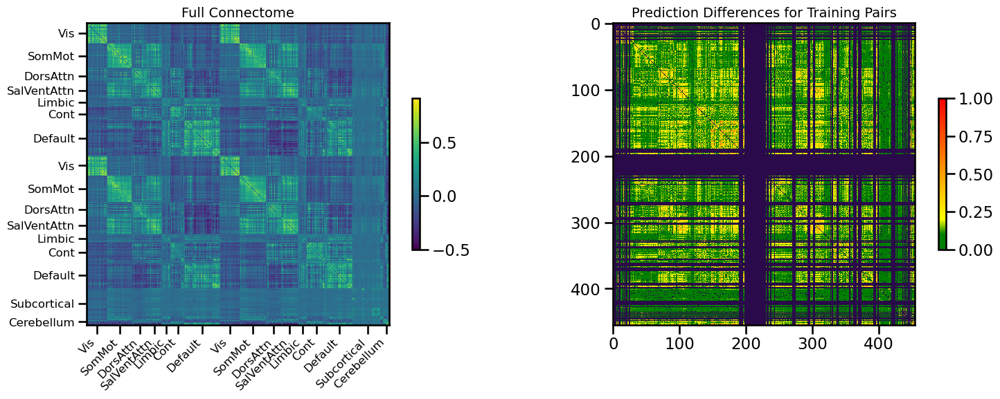

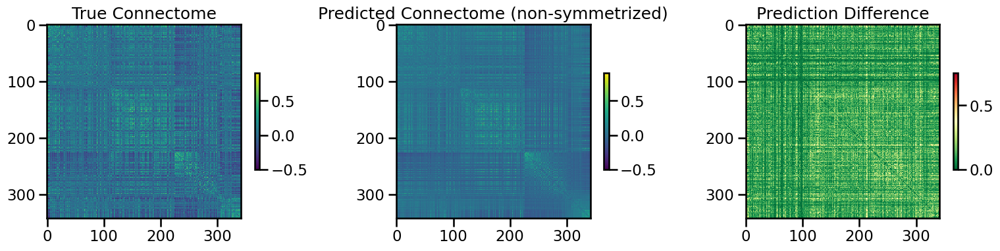

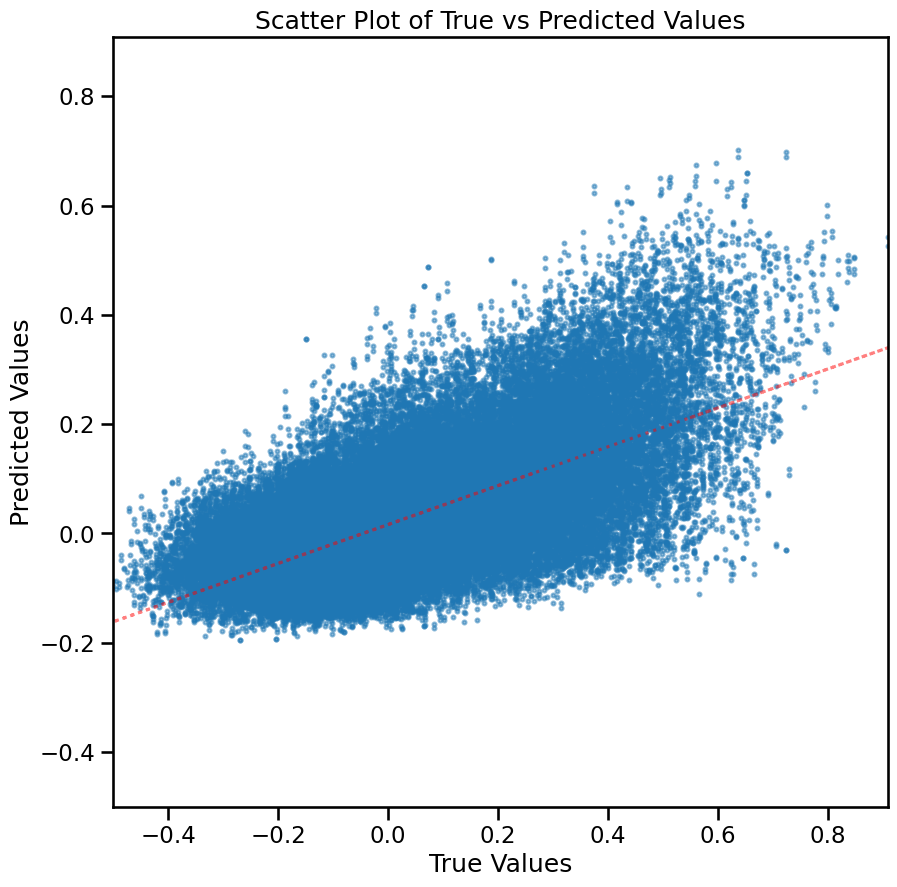

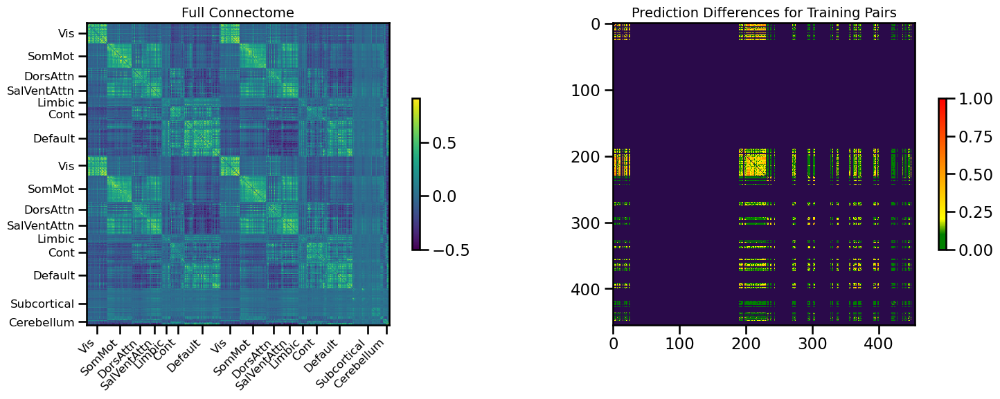

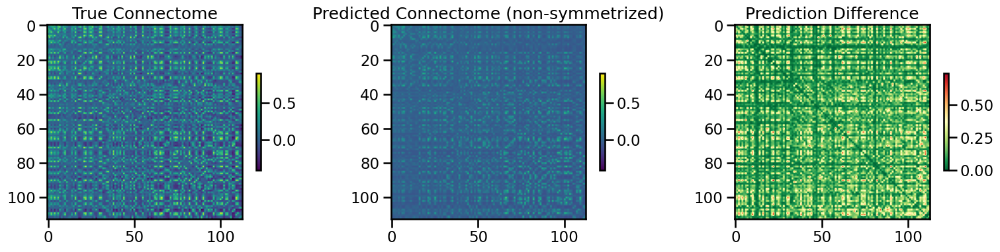

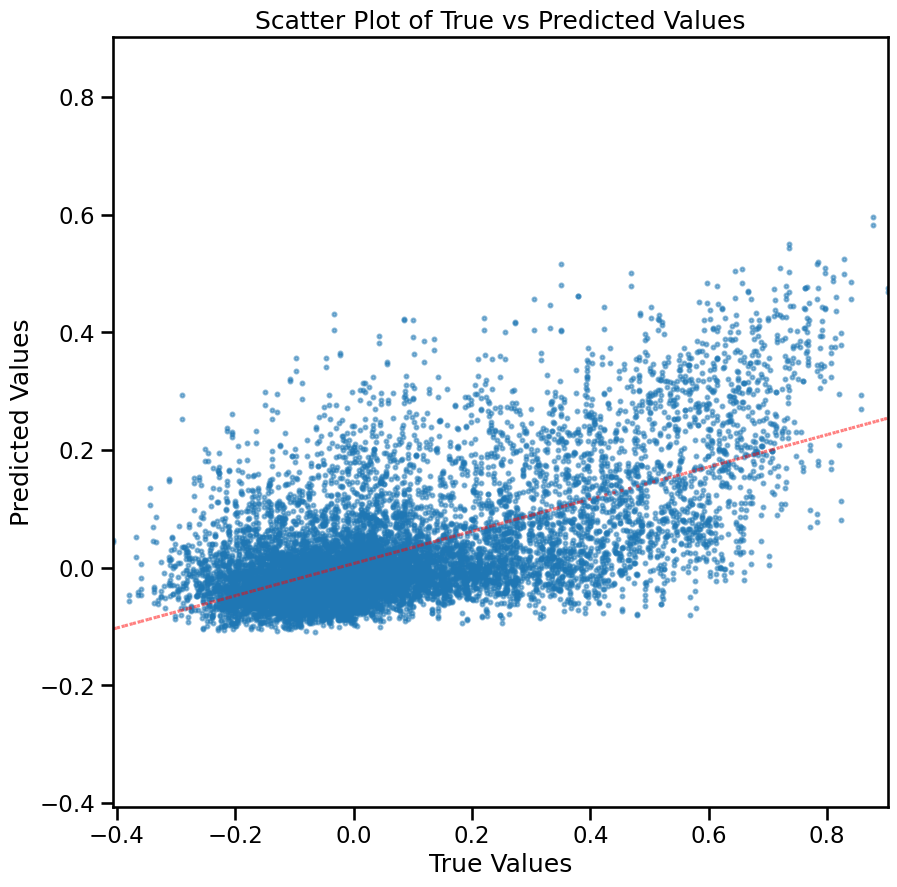

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.020851048, 'mae': 0.10736556, 'r2': 0.4173111824183654, 'pearson_corr': 0.6559687541114794, 'geodesic_distance': 22.80787745517647}
TEST METRICS: {'mse': 0.036238067, 'mae': 0.13743724, 'r2': 0.30732513573735454, 'pearson_corr': 0.6177056864724482, 'geodesic_distance': 13.48887724263697}
BEST VAL SCORE 0.02111837616190314
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.3, 'learning_rate': 0.0001, 'weight_decay': 0, 'batch_size': 256, 'epochs': 75}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▇▇█▇▇▆▆▅▅▄▄▃▃▃▂▂▂▂▁▂▁▁▂▂▁▁▁▁▂▁▂▂▂▂▂▁▂▂
train_mse_loss,█▃▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.02112
test_mse_loss,0.03646
train_mse_loss,0.02345


Final evaluation metrics logged successfully.
1
2
3


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: bipo2nn8
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/bipo2nn8
sweep_id bipo2nn8


wandb: Agent Starting Run: u8f2mgpb with config:
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	dropout_rate: 0.3
wandb: 	epochs: 100
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 0.0001
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  return self.__subclasscheck__(type(obj))

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.4113
Best val loss so far at epoch 3: 0.2456
Best val loss so far at epoch 4: 0.1333
Epoch 5/100, Train Loss: 0.0571, Val Loss: 0.0421
Best val loss so far at epoch 5: 0.0421
Best val loss so far at epoch 7: 0.0356
Best val loss so far at epoch 9: 0.0287
Epoch 10/100, Train Loss: 0.0318, Val Loss: 0.0258
Best val loss so far at epoch 10: 0.0258
Best val loss so far at epoch 12: 0.0254


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Epoch 15/100, Train Loss: 0.0282, Val Loss: 0.0269
Epoch 20/100, Train Loss: 0.0261, Val Loss: 0.0277
Best val loss so far at epoch 22: 0.0252
Epoch 25/100, Train Loss: 0.0245, Val Loss: 0.0307
Epoch 30/100, Train Loss: 0.0234, Val Loss: 0.0253

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.023807
Best val loss so far at epoch 31: 0.0238
Epoch 35/100, Train Loss: 0.0226, Val Loss: 0.0244
Best val loss so far at epoch 38: 0.0236
Epoch 40/100, Train Loss: 0.0223, Val Loss: 0.0237
Epoch 45/100, Train Loss: 0.0220, Val Loss: 0.0265
Epoch 50/100, Train Loss: 0.0215, Val Loss: 0.0276

LR REDUCED: 0.000030 → 0.000009 at Val Loss: 0.023595
Best val loss so far at epoch 53: 0.0236
Epoch 55/100, Train Loss: 0.0213, Val Loss: 0.0239
Best val loss so far at epoch 57: 0.0235
Best val loss so far at epoch 58: 0.0234
Epoch 60/100, Train Loss: 0.0211, Val Loss: 0.0239
Epoch 65/100, Train Loss: 0.0211, Val Loss: 0.0292
Epoch 70/100, Train Loss: 0.0210, Val Loss: 0.0234
Best val loss so far at epoch 70

fold0_epoch,▁▁▁▂▂▂▂▂▂▂▃▃▃▄▄▄▄▄▅▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇▇███
fold0_train_loss,█▆▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,92
fold0_train_loss,0.02052
fold0_val_loss,0.02429
inner_fold,0
mean_train_loss,0.02052


wandb: Agent Starting Run: rb85wax9 with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0.1
wandb: 	epochs: 75
wandb: 	hidden_dims: [256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 35585
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 1: 1.3042
Best val loss so far at epoch 2: 0.6015
Best val loss so far at epoch 3: 0.4487
Best val loss so far at epoch 4: 0.3385
Epoch 5/75, Train Loss: 0.0538, Val Loss: 0.2275
Best val loss so far at epoch 5: 0.2275
Best val loss so far at epoch 8: 0.2259
Best val loss so far at epoch 9: 0.1289
Epoch 10/75, Train Loss: 0.0376, Val Loss: 0.1227
Best val loss so far at epoch 10: 0.1227
Best val loss so far at epoch 12: 0.0658
Epoch 15/75, Train Loss: 0.0309, Val Loss: 0.0520
Best val loss so far at epoch 15: 0.0520
Best val loss so far at epoch 17: 0.0352
Epoch 20/75, Train Loss: 0.0274, Val Loss: 0.0333
Best val loss so far at epoch 20: 0.0333
Best val loss so far at epoch 24: 0.0310
Epoch 25/75, Train Loss: 0.0254, Val Loss: 0.0341
Best val loss so far at epoch 26: 0.0299
Best val loss so far at epoch 29: 0.0293
Epoch 30/75, Train Loss: 0.0243, Val Loss: 0.0315
Best val loss so far at epoch 34: 0.0291
Epoch 35/75, Train Loss: 0.0234, Val Loss: 0.0315
Be

fold0_epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇███
fold0_train_loss,█▇▆▅▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▄▃▃▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,65
fold0_train_loss,0.02093
fold0_val_loss,0.03009
inner_fold,0
mean_train_loss,0.02093


wandb: Agent Starting Run: e8echfnj with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	dropout_rate: 0
wandb: 	epochs: 100
wandb: 	hidden_dims: [512, 256, 128]
wandb: 	input_dim: 6
wandb: 	learning_rate: 9e-05
wandb: 	weight_decay: 1e-05
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.1693


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 2: 0.1586
Best val loss so far at epoch 3: 0.1335
Epoch 5/100, Train Loss: 0.0164, Val Loss: 0.1872
Best val loss so far at epoch 8: 0.1094
Epoch 10/100, Train Loss: 0.0132, Val Loss: 0.1483
Epoch 15/100, Train Loss: 0.0114, Val Loss: 0.1848
Epoch 20/100, Train Loss: 0.0104, Val Loss: 0.1772
Epoch 25/100, Train Loss: 0.0096, Val Loss: 0.2082

Early stopping triggered at epoch 28. Restoring best model with Val Loss: 0.1094


fold0_epoch,▁▁▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇██
fold0_train_loss,█▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▄▄▂▅▅▆▃▁▂▃▆▄▄▅▅█▃▄▃▅▃▇▄▄▇▃▇▄
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,27
fold0_train_loss,0.00917
fold0_val_loss,0.15946
inner_fold,0
mean_train_loss,0.00917


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'epochs': 100, 'binarize': False, 'input_dim': 6, 'batch_size': 256, 'hidden_dims': [512, 256, 128], 'dropout_rate': 0.3, 'weight_decay': 0.0001, 'learning_rate': 0.0001}
Number of learnable parameters in MLP: 169729
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0496
Best val loss so far at epoch 2: 0.0420
Best val loss so far at epoch 3: 0.0406
Best val loss so far at epoch 4: 0.0404
Epoch 5/100, Train Loss: 0.0270, Val Loss: 0.0399
Best val loss so far at epoch 5: 0.0399
Best val loss so far at epoch 6: 0.0397
Best val loss so far at epoch 7: 0.0392
Best val loss so far at epoch 8: 0.0384
Best val loss so far at epoch 9: 0.0382
Epoch 10/100, Train Loss: 0.0234, Val Loss: 0.0385
Best val loss so far at epoch 11: 0.0378
Best val loss so far at epoch 14: 0.0373
Epoch 15/100, Train Loss: 0.0211, Val Loss: 0.0370
Best val loss so far at epoch 15: 0.0370
Best val loss so far at epoch 17: 0.0363
Epoch 20/100, Train

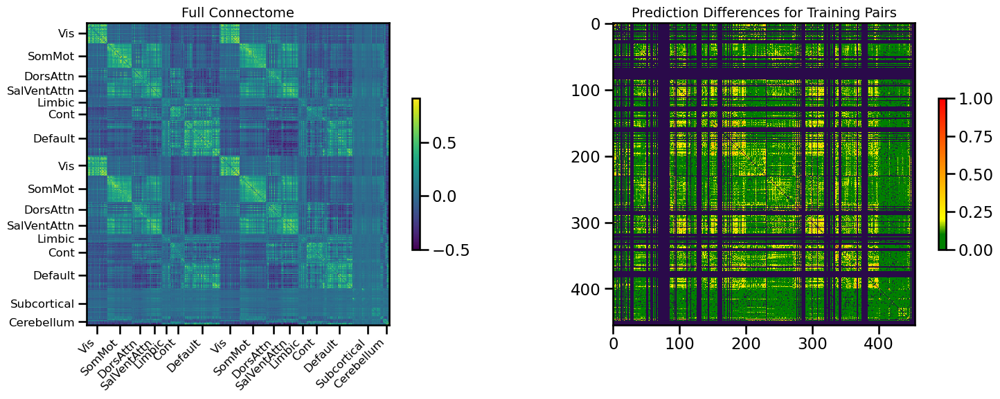

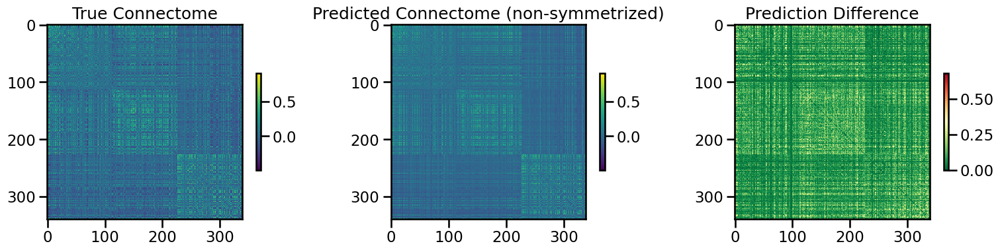

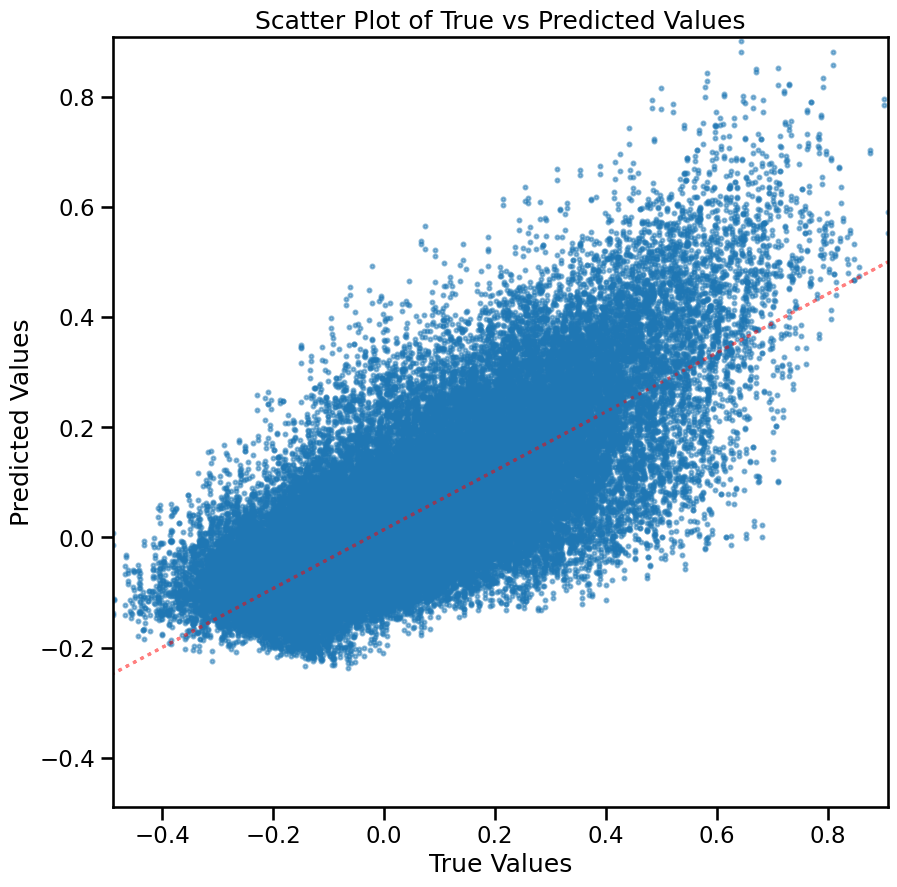

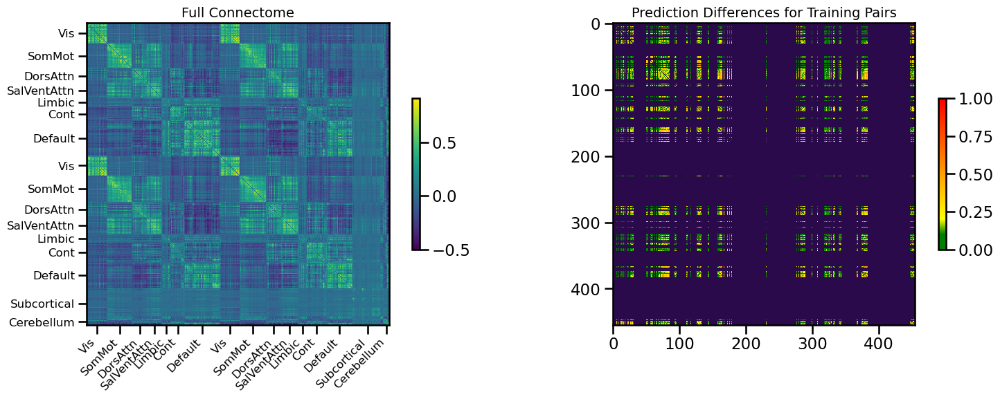

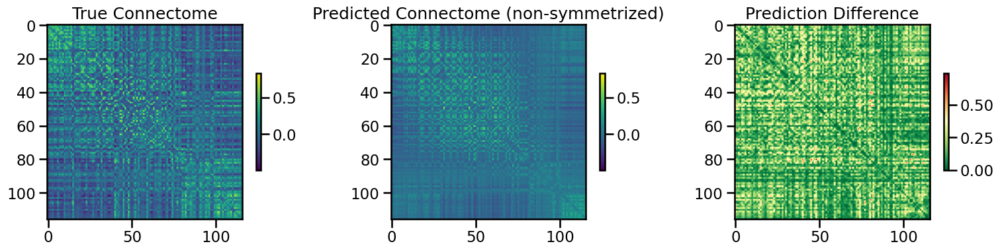

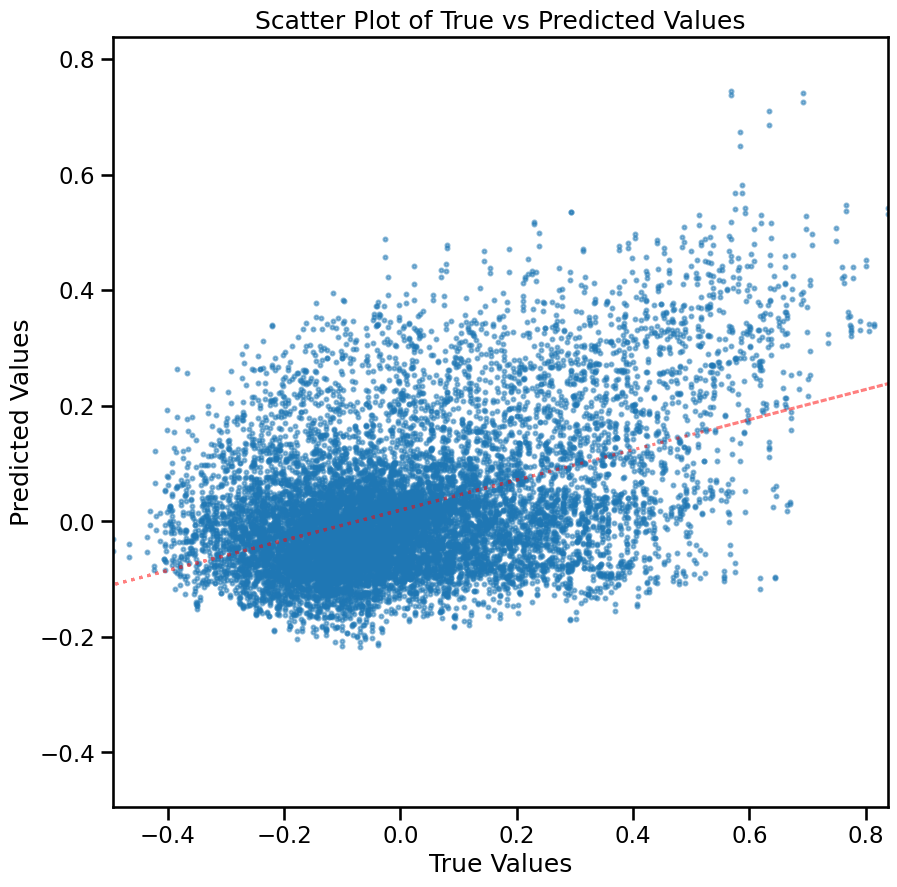

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.013856949, 'mae': 0.08409433, 'r2': 0.5680726552456301, 'pearson_corr': 0.7552046131725173, 'geodesic_distance': 20.14163489892708}
TEST METRICS: {'mse': 0.03748227, 'mae': 0.15039723, 'r2': 0.18278233326406246, 'pearson_corr': 0.44994550846707415, 'geodesic_distance': 12.993685654970966}
BEST VAL SCORE 0.02429232630878687
BEST MODEL HYPERPARAMS {'input_dim': 6, 'binarize': False, 'dropout_rate': 0.3, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 256, 'epochs': 100}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁▂▂▁▂▁▁▁▂▂▂▂▂▁▂▁▂▁▁▁
train_mse_loss,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0.02429
test_mse_loss,0.03719
train_mse_loss,0.01697


Final evaluation metrics logged successfully.
CPU Usage: 22.9%
RAM Usage: 24.4%
Available RAM: 761.3G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |


  gc.collect()



59068

In [8]:
# Run simulation
single_sim_run(
              cv_type='spatial',
              random_seed=42,
              model_type='dynamic_mlp',
              feature_type=[{'euclidean': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              impute_strategy=None,
              sort_genes='expression', 
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 4),
              save_sim=False,
              track_wandb=True,
              skip_cv=False
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

In [ ]:
# Run simulation
single_sim_run(
              cv_type='spatial',
              random_seed=42,
              model_type='dynamic_mlp',
              feature_type=[{'transcriptome': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              impute_strategy=None,
              gene_list='0.2',
              sort_genes='expression', 
              hemisphere='both',
              search_method=('wandb', 'mse', 4),
              save_sim=False,
              track_wandb=True,
              skip_cv=False
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

In [ ]:
# Run simulation
single_sim_run(
              cv_type='spatial',
              random_seed=42,
              model_type='shared_transformer',
              feature_type=[{'transcriptome': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              impute_strategy=None,
              sort_genes='expression', 
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 4),
              save_sim=False,
              track_wandb=True,
              skip_cv=False
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
Network coverage: 100.0% of regions
Network sizes: [113, 113, 113, 116]
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset
2
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 8ujnaylc
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/8ujnaylc
sweep_id 8ujnaylc


wandb: Agent Starting Run: rhngfy6e with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	d_model: 128
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.2
wandb: 	encoder_output_dim: 20
wandb: 	epochs: 50
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0
wandb: 	learning_rate: 1e-05
wandb: 	nhead: 2
wandb: 	num_layers: 4
wandb: 	token_encoder_dim: 30
wandb: 	transformer_dropout: 0.2
wandb: 	use_positional_encoding: False
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.04 GB
Best val loss so far at epoch 1: 0.0542


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 5/50, Train Loss: 0.1233, Val Loss: 0.0554
Epoch 10/50, Train Loss: 0.1042, Val Loss: 0.0576

Early stopping triggered at epoch 11. Restoring best model with Val Loss: 0.0542


fold0_epoch,▁▂▂▃▄▅▅▆▇▇█
fold0_train_loss,█▄▃▃▂▂▂▁▁▁▁
fold0_val_loss,▁▂██▂▃▅▂▄▅▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,10
fold0_train_loss,0.10107
fold0_val_loss,0.05507
inner_fold,0
mean_train_loss,0.10107


wandb: Agent Starting Run: 3iszmof1 with config:
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	d_model: 128
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 20
wandb: 	epochs: 50
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 4
wandb: 	num_layers: 2
wandb: 	token_encoder_dim: 30
wandb: 	transformer_dropout: 0.1
wandb: 	use_positional_encoding: False
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.04 GB
Best val loss so far at epoch 1: 0.0593
Best val loss so far at epoch 2: 0.0533
Best val loss so far at epoch 3: 0.0526
Best val loss so far at epoch 4: 0.0525
Epoch 5/50, Train Loss: 0.0358, Val Loss: 0.0516
Best val loss so far at epoch 5: 0.0516
Best val loss so far at epoch 6: 0.0438
Best val loss so far at epoch 8: 0.0431
Best val loss so far at epoch 9: 0.0417
Epoch 10/50, Train Loss: 0.0146, Val Loss: 0.0417
Best val loss so far at epoch 10: 0.0417


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 12: 0.0397
Best val loss so far at epoch 13: 0.0392
Epoch 15/50, Train Loss: 0.0072, Val Loss: 0.0384
Best val loss so far at epoch 15: 0.0384
Epoch 20/50, Train Loss: 0.0045, Val Loss: 0.0413
Epoch 25/50, Train Loss: 0.0035, Val Loss: 0.0411

Early stopping triggered at epoch 25. Restoring best model with Val Loss: 0.0384


fold0_epoch,▁▁▂▂▂▂▃▃▃▄▄▄▅▅▅▅▆▆▆▇▇▇▇██
fold0_train_loss,█▆▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▆▆▆▅▃▄▃▂▂▂▁▁▁▁▂▂▂▃▂▁▁▂▃▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,24
fold0_train_loss,0.00346
fold0_val_loss,0.0411
inner_fold,0
mean_train_loss,0.00346


wandb: Agent Starting Run: sn0t6sqs with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.2
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 50
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0
wandb: 	learning_rate: 1e-05
wandb: 	nhead: 4
wandb: 	num_layers: 2
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.2
wandb: 	use_positional_encoding: False
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.1525
Best val loss so far at epoch 2: 0.0955
Best val loss so far at epoch 3: 0.0860
Best val loss so far at epoch 4: 0.0737


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 5/50, Train Loss: 0.1691, Val Loss: 0.0707
Best val loss so far at epoch 5: 0.0707
Best val loss so far at epoch 6: 0.0661
Best val loss so far at epoch 7: 0.0643
Best val loss so far at epoch 9: 0.0614
Epoch 10/50, Train Loss: 0.1344, Val Loss: 0.0641
Best val loss so far at epoch 11: 0.0575
Best val loss so far at epoch 14: 0.0531
Epoch 15/50, Train Loss: 0.1179, Val Loss: 0.0540
Best val loss so far at epoch 17: 0.0513
Epoch 20/50, Train Loss: 0.1062, Val Loss: 0.0578
Epoch 25/50, Train Loss: 0.0960, Val Loss: 0.0531

Early stopping triggered at epoch 27. Restoring best model with Val Loss: 0.0513


fold0_epoch,▁▁▂▂▂▂▃▃▃▃▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇██
fold0_train_loss,█▅▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,█▄▃▃▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,26
fold0_train_loss,0.09182
fold0_val_loss,0.05235
inner_fold,0
mean_train_loss,0.09182


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'nhead': 4, 'epochs': 50, 'd_model': 128, 'binarize': False, 'input_dim': 14760, 'batch_size': 256, 'lambda_reg': 0, 'num_layers': 2, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'learning_rate': 9e-05, 'deep_hidden_dims': [256, 128], 'token_encoder_dim': 30, 'encoder_output_dim': 20, 'transformer_dropout': 0.1, 'use_positional_encoding': False}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.04 GB
Best val loss so far at epoch 1: 0.0244
Epoch 5/50, Train Loss: 0.0162, Val Loss: 0.0363
Epoch 10/50, Train Loss: 0.0055, Val Loss: 0.0326

Early stopping triggered at epoch 11. Restoring best model with Val Loss: 0.0244


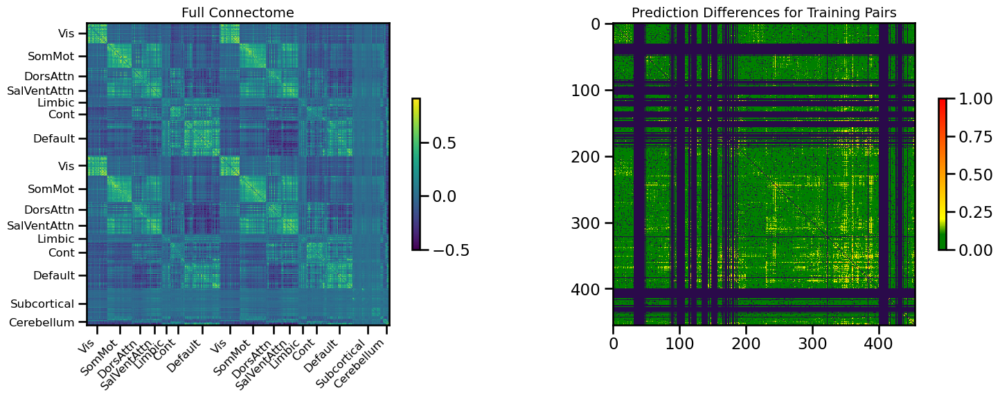

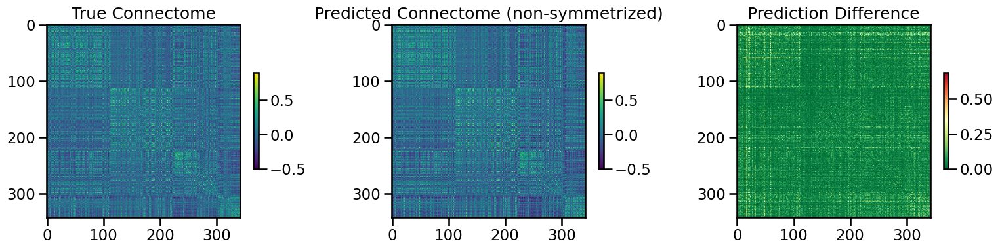

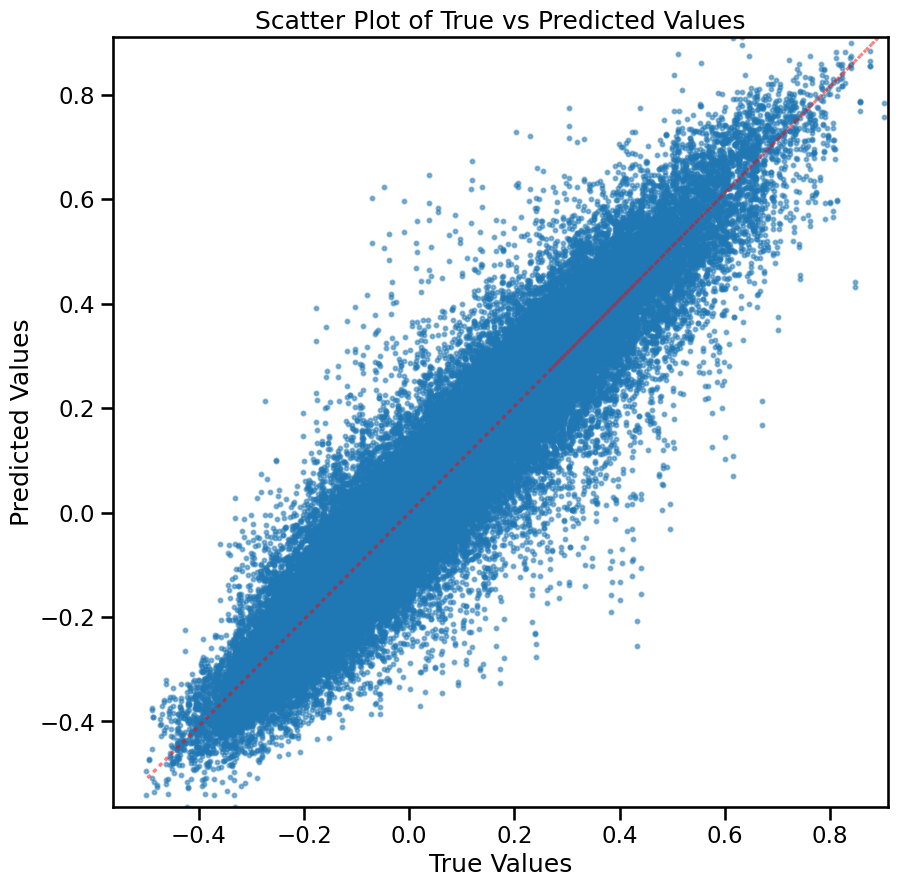

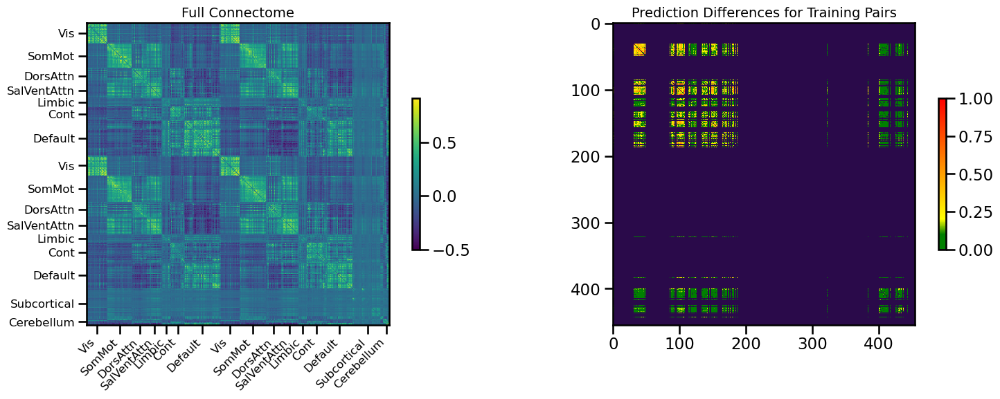

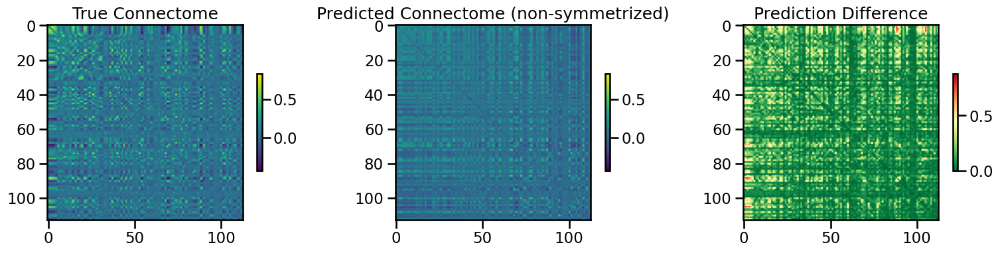

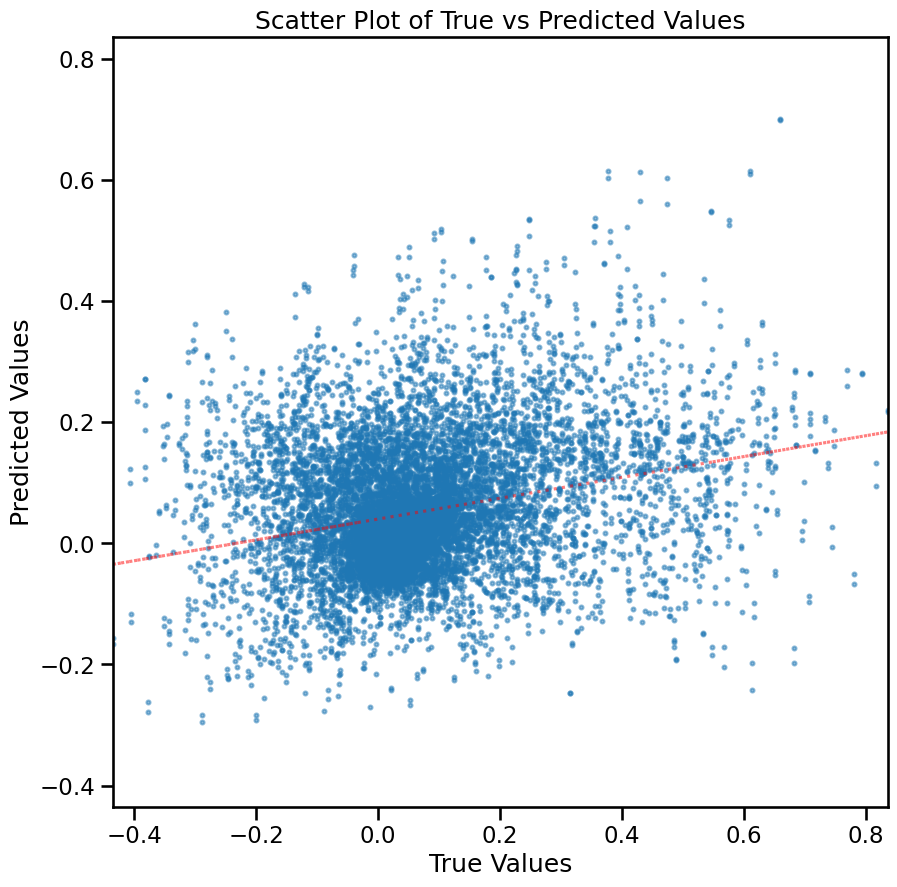

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.00500772, 'mae': 0.049891025, 'r2': 0.872792175366176, 'pearson_corr': 0.9440795681471899, 'geodesic_distance': 14.922860400626863}
TEST METRICS: {'mse': 0.027737334, 'mae': 0.11336425, 'r2': -0.09870560313717447, 'pearson_corr': 0.2610982806538631, 'geodesic_distance': 15.33681715310854}
BEST VAL SCORE 0.04109926328063011
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 128, 'encoder_output_dim': 20, 'nhead': 4, 'num_layers': 2, 'deep_hidden_dims': [256, 128], 'use_positional_encoding': False, 'transformer_dropout': 0.1, 'dropout_rate': 0.1, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 256, 'epochs': 50}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▁▁█▂▂▁▁▁▁▂▁
train_mse_loss,█▅▄▃▂▂▁▁▁▁▁
best_val_loss,0.0411
test_mse_loss,0.0275
train_mse_loss,0.00486


Final evaluation metrics logged successfully.
1
3
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: za546vya
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/za546vya
sweep_id za546vya


wandb: Agent Starting Run: tc0whss4 with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 20
wandb: 	epochs: 50
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 2
wandb: 	num_layers: 2
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.1
wandb: 	use_positional_encoding: False
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.08 GB


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 1: 0.1040
Epoch 5/50, Train Loss: 0.0575, Val Loss: 0.1186
Best val loss so far at epoch 6: 0.1001
Best val loss so far at epoch 7: 0.0549
Best val loss so far at epoch 8: 0.0535
Best val loss so far at epoch 9: 0.0364
Epoch 10/50, Train Loss: 0.0387, Val Loss: 0.0393
Best val loss so far at epoch 11: 0.0358
Best val loss so far at epoch 14: 0.0341
Epoch 15/50, Train Loss: 0.0238, Val Loss: 0.0281
Best val loss so far at epoch 15: 0.0281
Best val loss so far at epoch 16: 0.0269
Best val loss so far at epoch 19: 0.0258
Epoch 20/50, Train Loss: 0.0153, Val Loss: 0.0287
Epoch 25/50, Train Loss: 0.0104, Val Loss: 0.0290
Best val loss so far at epoch 26: 0.0252
Epoch 30/50, Train Loss: 0.0077, Val Loss: 0.0269
Epoch 35/50, Train Loss: 0.0060, Val Loss: 0.0258

Early stopping triggered at epoch 36. Restoring best model with Val Loss: 0.0252


fold0_epoch,▁▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇███
fold0_train_loss,█▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▆▇█▇▇▆▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,35
fold0_train_loss,0.00578
fold0_val_loss,0.02755
inner_fold,0
mean_train_loss,0.00578


wandb: Agent Starting Run: xpcckmh9 with config:
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 50
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 4
wandb: 	num_layers: 4
wandb: 	token_encoder_dim: 20
wandb: 	transformer_dropout: 0.2
wandb: 	use_positional_encoding: False
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.0297
Best val loss so far at epoch 2: 0.0266
Best val loss so far at epoch 4: 0.0266
Epoch 5/50, Train Loss: 0.0386, Val Loss: 0.0252
Best val loss so far at epoch 5: 0.0252


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Epoch 10/50, Train Loss: 0.0181, Val Loss: 0.0262
Epoch 15/50, Train Loss: 0.0097, Val Loss: 0.0252

Early stopping triggered at epoch 15. Restoring best model with Val Loss: 0.0252


fold0_epoch,▁▁▂▃▃▃▄▅▅▅▆▇▇▇█
fold0_train_loss,█▅▄▄▃▃▂▂▂▂▁▁▁▁▁
fold0_val_loss,█▃█▃▁▁▃▅▁▃▂▂▂▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,14
fold0_train_loss,0.00968
fold0_val_loss,0.02519
inner_fold,0
mean_train_loss,0.00968


wandb: Agent Starting Run: opybo111 with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	d_model: 128
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 50
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0
wandb: 	learning_rate: 1e-05
wandb: 	nhead: 2
wandb: 	num_layers: 4
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.1
wandb: 	use_positional_encoding: False
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.1318


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 3: 0.0699
Epoch 5/50, Train Loss: 0.0797, Val Loss: 0.0516
Best val loss so far at epoch 5: 0.0516
Best val loss so far at epoch 7: 0.0502
Epoch 10/50, Train Loss: 0.0672, Val Loss: 0.1505
Epoch 15/50, Train Loss: 0.0590, Val Loss: 0.0561
Best val loss so far at epoch 17: 0.0405
Epoch 20/50, Train Loss: 0.0538, Val Loss: 0.1378
Epoch 25/50, Train Loss: 0.0493, Val Loss: 0.0499

Early stopping triggered at epoch 27. Restoring best model with Val Loss: 0.0405


fold0_epoch,▁▁▂▂▂▂▃▃▃▃▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇██
fold0_train_loss,█▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
fold0_val_loss,▅▆▂▃▁▂▁▃█▅▃▂▃▂▂▃▁▅▅▅▂▂▂▂▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,26
fold0_train_loss,0.04804
fold0_val_loss,0.04142
inner_fold,0
mean_train_loss,0.04804


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'nhead': 4, 'epochs': 50, 'd_model': 64, 'binarize': False, 'input_dim': 14760, 'batch_size': 256, 'lambda_reg': 0, 'num_layers': 4, 'dropout_rate': 0.1, 'weight_decay': 0, 'learning_rate': 9e-05, 'deep_hidden_dims': [256, 128], 'token_encoder_dim': 20, 'encoder_output_dim': 10, 'transformer_dropout': 0.2, 'use_positional_encoding': False}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.0560
Best val loss so far at epoch 2: 0.0440
Epoch 5/50, Train Loss: 0.0254, Val Loss: 0.0665
Epoch 10/50, Train Loss: 0.0105, Val Loss: 0.0882

Early stopping triggered at epoch 12. Restoring best model with Val Loss: 0.0440


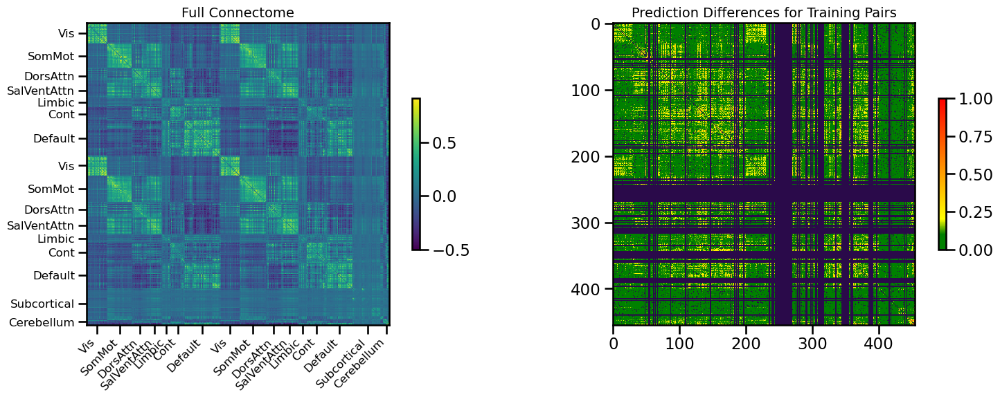

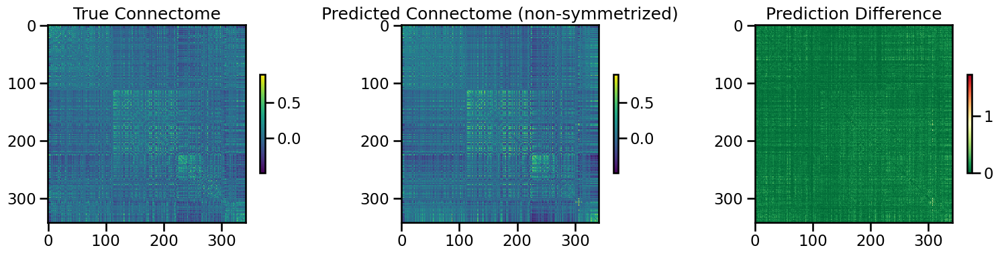

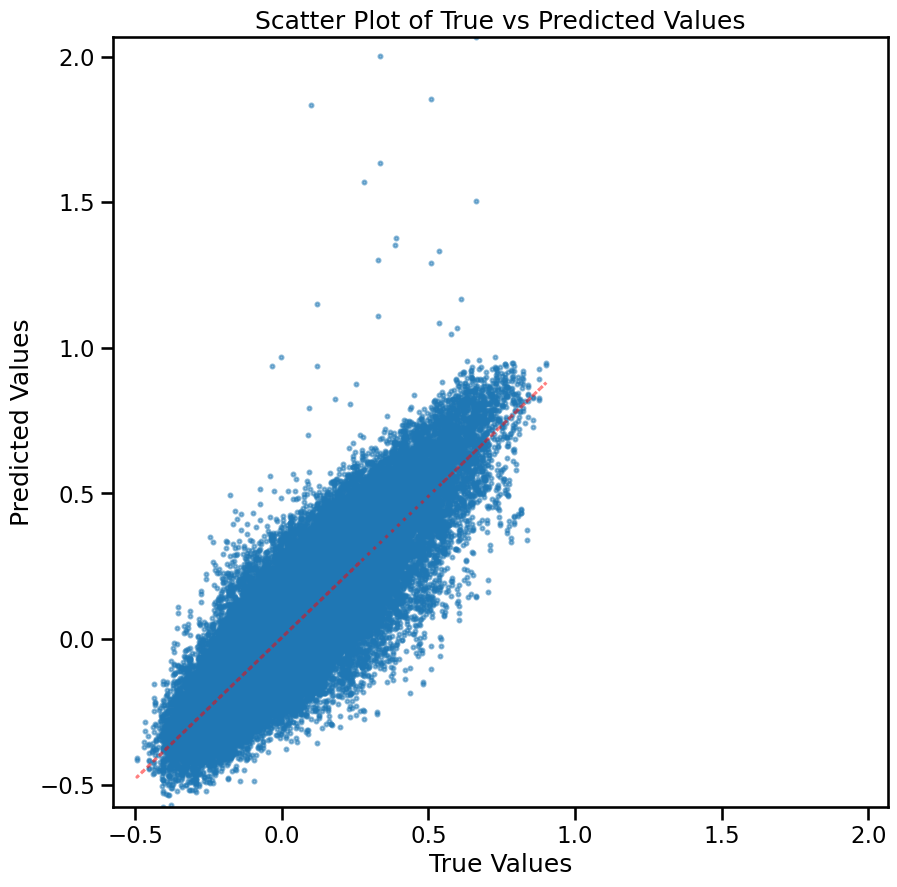

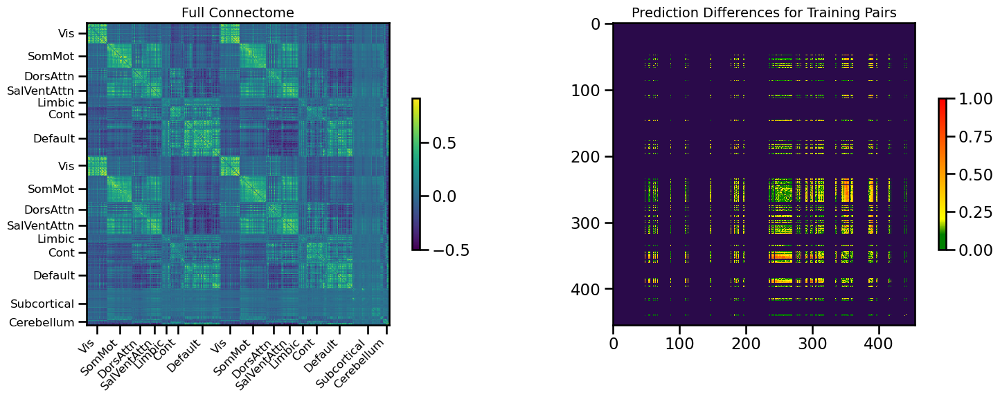

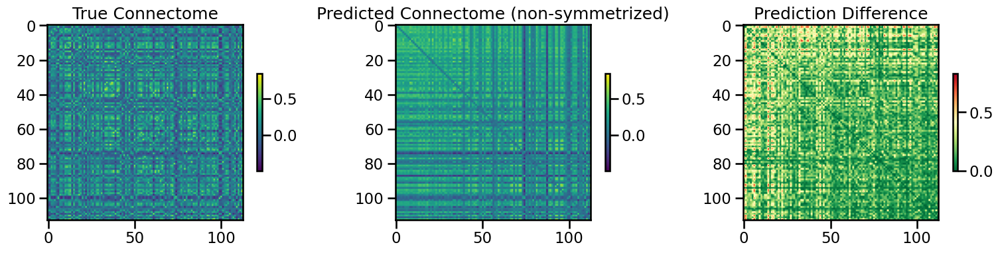

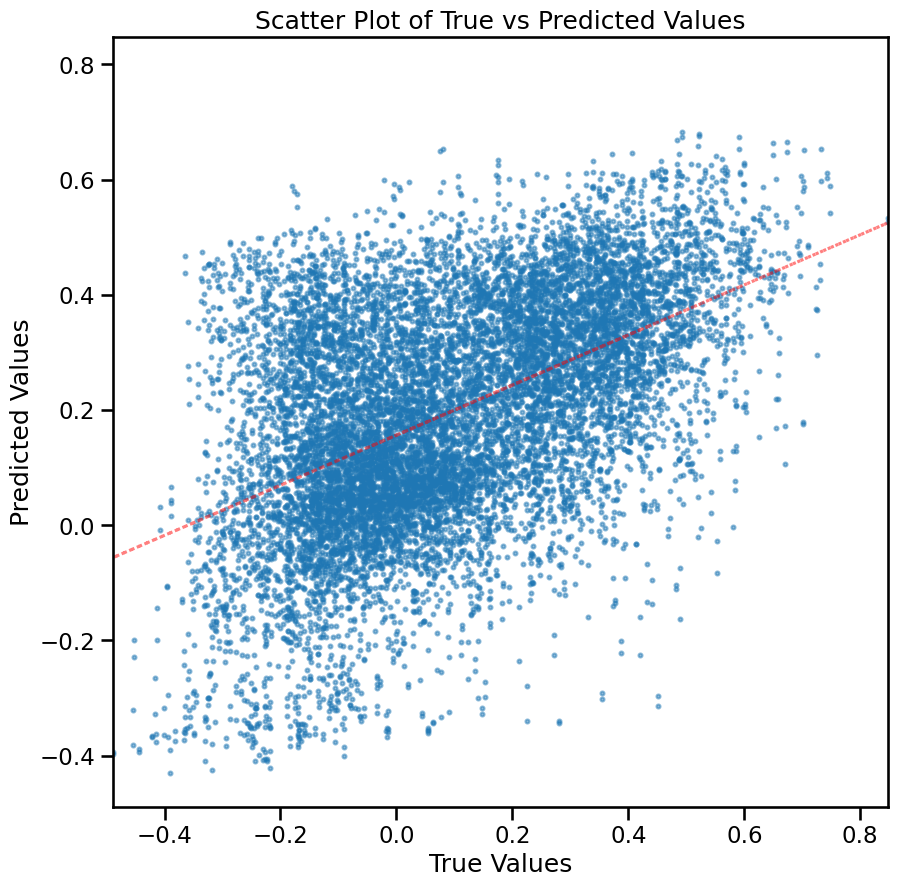

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.010332492, 'mae': 0.07286941, 'r2': 0.6803302405848644, 'pearson_corr': 0.8645278271700502, 'geodesic_distance': 19.861476306610417}
TEST METRICS: {'mse': 0.055346817, 'mae': 0.18115856, 'r2': -0.08229926406899746, 'pearson_corr': 0.5052269697607257, 'geodesic_distance': 10.245818904753406}
BEST VAL SCORE 0.025193000920116903
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 64, 'encoder_output_dim': 10, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'use_positional_encoding': False, 'transformer_dropout': 0.2, 'dropout_rate': 0.1, 'learning_rate': 9e-05, 'weight_decay': 0, 'lambda_reg': 0, 'batch_size': 256, 'epochs': 50}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▃▁▂▂▄▅█▇▄▇▅▃
train_mse_loss,█▅▄▃▃▂▂▂▁▁▁▁
best_val_loss,0.02519
test_mse_loss,0.0549
train_mse_loss,0.00812


Final evaluation metrics logged successfully.
1
2
4


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: rhmnjbbe
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/rhmnjbbe
sweep_id rhmnjbbe


wandb: Agent Starting Run: sbxipq9u with config:
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 75
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0
wandb: 	learning_rate: 1e-05
wandb: 	nhead: 4
wandb: 	num_layers: 4
wandb: 	token_encoder_dim: 20
wandb: 	transformer_dropout: 0.2
wandb: 	use_positional_encoding: False
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.06 GB


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 1: 0.0340
Best val loss so far at epoch 2: 0.0290
Best val loss so far at epoch 3: 0.0283
Best val loss so far at epoch 4: 0.0273
Epoch 5/75, Train Loss: 0.0806, Val Loss: 0.0265
Best val loss so far at epoch 5: 0.0265
Best val loss so far at epoch 6: 0.0250
Best val loss so far at epoch 8: 0.0241
Epoch 10/75, Train Loss: 0.0672, Val Loss: 0.0239
Best val loss so far at epoch 10: 0.0239
Epoch 15/75, Train Loss: 0.0582, Val Loss: 0.0250
Epoch 20/75, Train Loss: 0.0519, Val Loss: 0.0260

Early stopping triggered at epoch 20. Restoring best model with Val Loss: 0.0239


fold0_epoch,▁▁▂▂▂▃▃▄▄▄▅▅▅▆▆▇▇▇██
fold0_train_loss,█▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁
fold0_val_loss,█▅▄▃▃▂▂▁▁▁▁▁▂▁▂▃▂▂▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,19
fold0_train_loss,0.05187
fold0_val_loss,0.02597
inner_fold,0
mean_train_loss,0.05187


wandb: Agent Starting Run: sacp2eq1 with config:
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.2
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 50
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0
wandb: 	learning_rate: 1e-05
wandb: 	nhead: 2
wandb: 	num_layers: 4
wandb: 	token_encoder_dim: 30
wandb: 	transformer_dropout: 0.2
wandb: 	use_positional_encoding: False
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0387
Best val loss so far at epoch 2: 0.0293
Best val loss so far at epoch 3: 0.0292
Best val loss so far at epoch 4: 0.0290
Epoch 5/50, Train Loss: 0.1255, Val Loss: 0.0282
Best val loss so far at epoch 5: 0.0282
Best val loss so far at epoch 6: 0.0275


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 7: 0.0272
Epoch 10/50, Train Loss: 0.1037, Val Loss: 0.0285
Epoch 15/50, Train Loss: 0.0869, Val Loss: 0.0273

Early stopping triggered at epoch 17. Restoring best model with Val Loss: 0.0272


fold0_epoch,▁▁▂▂▃▃▄▄▅▅▅▆▆▇▇██
fold0_train_loss,█▅▄▃▃▃▂▂▂▂▂▂▁▁▁▁▁
fold0_val_loss,█▂▂▂▂▁▁▁▂▂▂▂▁▁▁▁▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,16
fold0_train_loss,0.0819
fold0_val_loss,0.02875
inner_fold,0
mean_train_loss,0.0819


wandb: Agent Starting Run: fw3u1jo1 with config:
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 20
wandb: 	epochs: 50
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0
wandb: 	learning_rate: 1e-05
wandb: 	nhead: 4
wandb: 	num_layers: 4
wandb: 	token_encoder_dim: 20
wandb: 	transformer_dropout: 0.1
wandb: 	use_positional_encoding: False
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.07 GB
Best val loss so far at epoch 1: 0.0295


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Epoch 5/50, Train Loss: 0.0791, Val Loss: 0.0293
Best val loss so far at epoch 5: 0.0293
Best val loss so far at epoch 7: 0.0261
Best val loss so far at epoch 9: 0.0259
Epoch 10/50, Train Loss: 0.0680, Val Loss: 0.0272
Epoch 15/50, Train Loss: 0.0565, Val Loss: 0.0280
Best val loss so far at epoch 16: 0.0240
Best val loss so far at epoch 18: 0.0239
Epoch 20/50, Train Loss: 0.0490, Val Loss: 0.0251
Epoch 25/50, Train Loss: 0.0426, Val Loss: 0.0249

LR REDUCED: 0.000010 → 0.000003 at Val Loss: 0.024976

Early stopping triggered at epoch 28. Restoring best model with Val Loss: 0.0239


fold0_epoch,▁▁▂▂▂▂▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▇▇▇▇██
fold0_train_loss,█▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁
fold0_val_loss,▅▆█▅▅▇▂▄▂▃▃▄▃▃▄▁▄▁▄▂▃▃▂▂▂▃▁▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,27
fold0_train_loss,0.03862
fold0_val_loss,0.02498
inner_fold,0
mean_train_loss,0.03862


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'nhead': 4, 'epochs': 50, 'd_model': 64, 'binarize': False, 'input_dim': 14760, 'batch_size': 256, 'lambda_reg': 0, 'num_layers': 4, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'learning_rate': 1e-05, 'deep_hidden_dims': [256, 128], 'token_encoder_dim': 20, 'encoder_output_dim': 20, 'transformer_dropout': 0.1, 'use_positional_encoding': False}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.07 GB
Best val loss so far at epoch 1: 0.0580
Best val loss so far at epoch 2: 0.0564
Best val loss so far at epoch 3: 0.0466
Best val loss so far at epoch 4: 0.0461
Epoch 5/50, Train Loss: 0.0651, Val Loss: 0.0479
Epoch 10/50, Train Loss: 0.0490, Val Loss: 0.0502
Best val loss so far at epoch 13: 0.0460
Epoch 15/50, Train Loss: 0.0376, Val Loss: 0.0467
Epoch 20/50, Train Loss: 0.0286, Val Loss: 0.0604

Early stopping triggered at epoch 23. Restoring best model with Val Loss: 0.0460


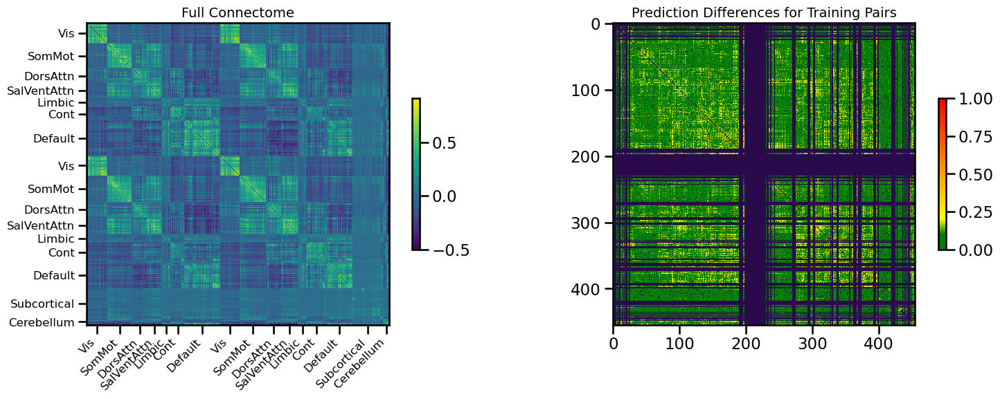

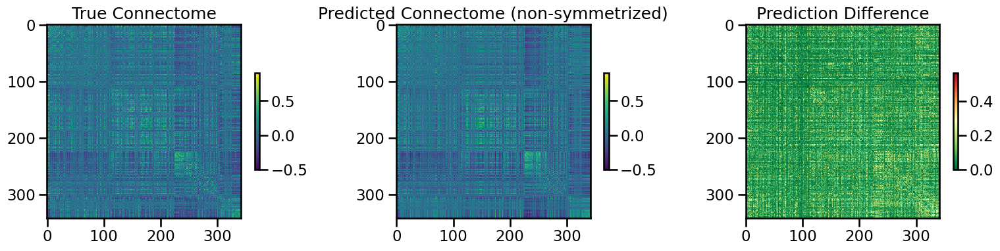

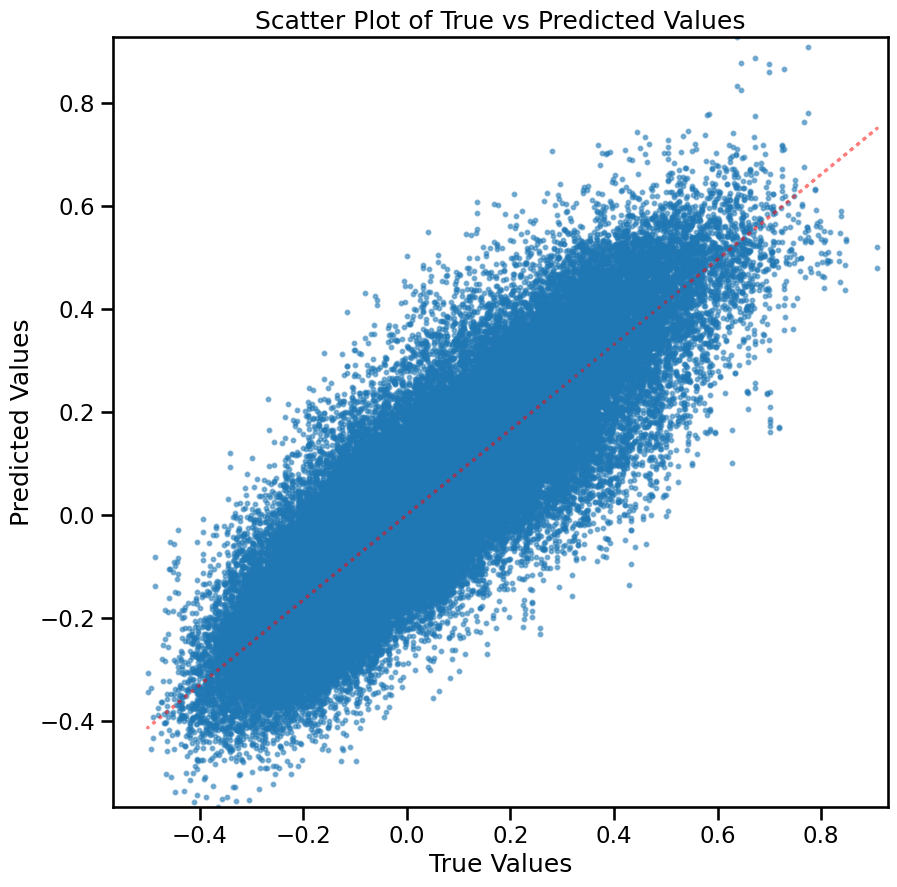

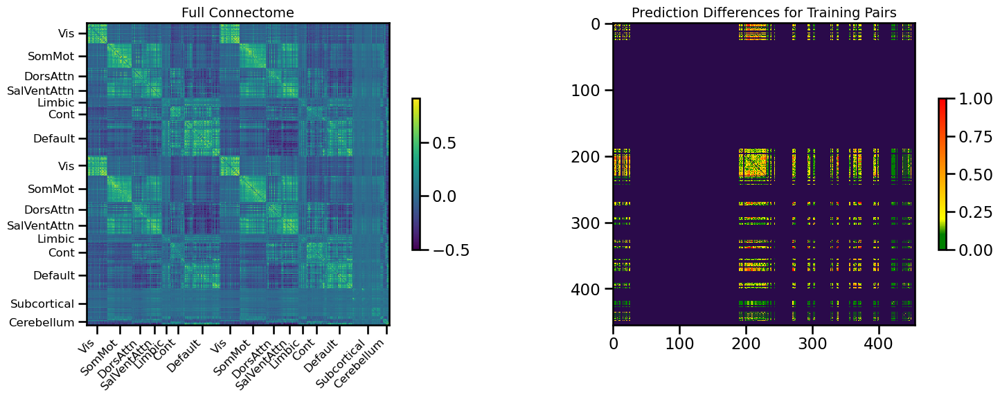

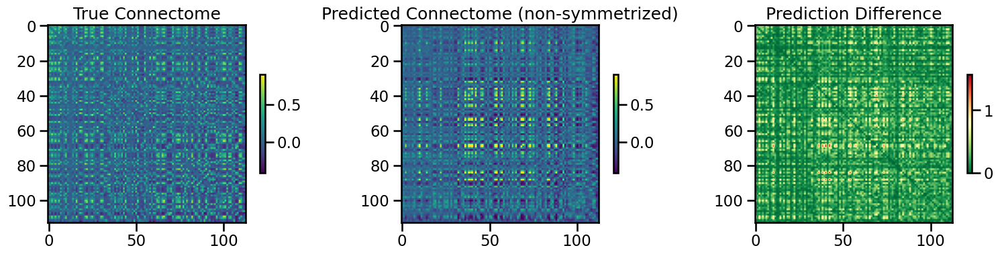

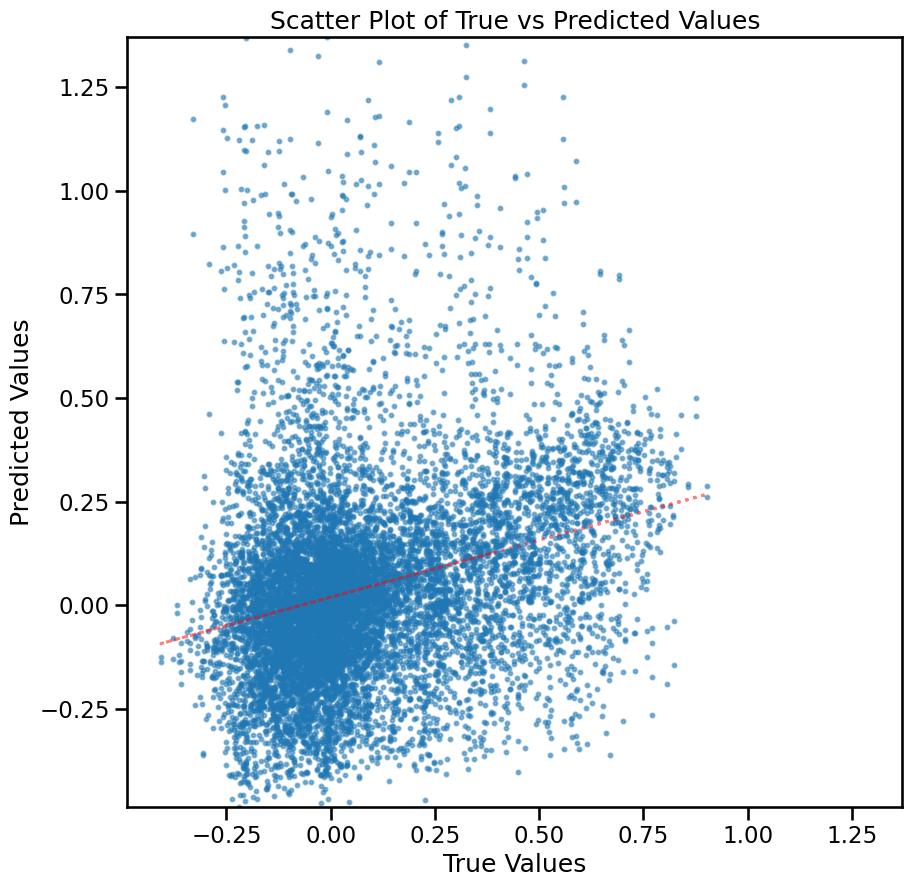

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.009886042, 'mae': 0.07427047, 'r2': 0.7237315757410232, 'pearson_corr': 0.8577479236556008, 'geodesic_distance': 21.54880651621069}
TEST METRICS: {'mse': 0.0783434, 'mae': 0.20067745, 'r2': -0.4975002342243122, 'pearson_corr': 0.27194534393089015, 'geodesic_distance': 15.629447195121617}
BEST VAL SCORE 0.024976405948400497
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 20, 'd_model': 64, 'encoder_output_dim': 20, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'use_positional_encoding': False, 'transformer_dropout': 0.1, 'dropout_rate': 0.1, 'learning_rate': 1e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 256, 'epochs': 50}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▄▃▁▁▁▁▂▁▂▂▁▁▁▁▁▂▃▃▃▄▅██
train_mse_loss,█▆▅▅▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁▁
best_val_loss,0.02498
test_mse_loss,0.07798
train_mse_loss,0.02406


Final evaluation metrics logged successfully.
1
2
3


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: j6qiyt51
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/j6qiyt51
sweep_id j6qiyt51


wandb: Agent Starting Run: m1xbvtb8 with config:
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.1
wandb: 	encoder_output_dim: 20
wandb: 	epochs: 75
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 2
wandb: 	num_layers: 4
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.1
wandb: 	use_positional_encoding: False
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.1164


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx

  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Best val loss so far at epoch 2: 0.0299
Best val loss so far at epoch 3: 0.0253
Best val loss so far at epoch 4: 0.0228
Epoch 5/75, Train Loss: 0.0372, Val Loss: 0.0229
Best val loss so far at epoch 6: 0.0228
Best val loss so far at epoch 7: 0.0213
Epoch 10/75, Train Loss: 0.0189, Val Loss: 0.0578
Epoch 15/75, Train Loss: 0.0109, Val Loss: 0.0415

Early stopping triggered at epoch 17. Restoring best model with Val Loss: 0.0213


fold0_epoch,▁▁▂▂▃▃▄▄▅▅▅▆▆▇▇██
fold0_train_loss,█▅▄▄▃▃▂▂▂▂▂▁▁▁▁▁▁
fold0_val_loss,█▂▁▁▁▁▁▁▁▄▄▂▄▃▂▂▂
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,16
fold0_train_loss,0.00904
fold0_val_loss,0.03763
inner_fold,0
mean_train_loss,0.00904


wandb: Agent Starting Run: otm8o6k9 with config:
wandb: 	batch_size: 512
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.2
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 75
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0
wandb: 	learning_rate: 1e-05
wandb: 	nhead: 4
wandb: 	num_layers: 4
wandb: 	token_encoder_dim: 30
wandb: 	transformer_dropout: 0.1
wandb: 	use_positional_encoding: False
wandb: 	weight_decay: 0.0001
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.1421
Best val loss so far at epoch 2: 0.0947
Best val loss so far at epoch 3: 0.0811
Best val loss so far at epoch 4: 0.0784


  transposed = list(zip(*batch))  # It may be accessed twice, so we use a list.



Epoch 5/75, Train Loss: 0.1405, Val Loss: 0.0660
Best val loss so far at epoch 5: 0.0660
Best val loss so far at epoch 6: 0.0560
Best val loss so far at epoch 7: 0.0506
Epoch 10/75, Train Loss: 0.1187, Val Loss: 0.0524
Epoch 15/75, Train Loss: 0.1046, Val Loss: 0.0521
Best val loss so far at epoch 16: 0.0498
Best val loss so far at epoch 18: 0.0457
Best val loss so far at epoch 19: 0.0444
Epoch 20/75, Train Loss: 0.0942, Val Loss: 0.0449
Best val loss so far at epoch 23: 0.0421
Epoch 25/75, Train Loss: 0.0826, Val Loss: 0.0414
Best val loss so far at epoch 25: 0.0414
Best val loss so far at epoch 26: 0.0389
Best val loss so far at epoch 27: 0.0379
Best val loss so far at epoch 28: 0.0368
Best val loss so far at epoch 29: 0.0338
Epoch 30/75, Train Loss: 0.0755, Val Loss: 0.0334
Best val loss so far at epoch 30: 0.0334
Best val loss so far at epoch 32: 0.0323
Best val loss so far at epoch 33: 0.0315
Best val loss so far at epoch 34: 0.0307
Epoch 35/75, Train Loss: 0.0676, Val Loss: 0.029

fold0_epoch,▁▂▂▂▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇██
fold0_train_loss,█▅▅▄▄▄▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁
fold0_val_loss,█▅▄▃▃▃▃▃▃▃▃▃▂▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,55
fold0_train_loss,0.04076
fold0_val_loss,0.0279
inner_fold,0
mean_train_loss,0.04076


wandb: Agent Starting Run: x215mkfl with config:
wandb: 	batch_size: 256
wandb: 	binarize: False
wandb: 	d_model: 64
wandb: 	deep_hidden_dims: [256, 128]
wandb: 	dropout_rate: 0.2
wandb: 	encoder_output_dim: 10
wandb: 	epochs: 50
wandb: 	input_dim: 14760
wandb: 	lambda_reg: 0
wandb: 	learning_rate: 9e-05
wandb: 	nhead: 2
wandb: 	num_layers: 2
wandb: 	token_encoder_dim: 60
wandb: 	transformer_dropout: 0.1
wandb: 	use_positional_encoding: False
wandb: 	weight_decay: 0
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
  self._sweep_config = config_util.dict_from_config_file(

  self.comm = Comm(**args)

wandb: WARNING Ignored wandb.init() arg project when running a sweep.
  from IPython.core.display import HTML, display  # type: ignore



Processing inner fold 0


  warnings.warn(



Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0300
Best val loss so far at epoch 2: 0.0288
Best val loss so far at epoch 3: 0.0261
Epoch 5/50, Train Loss: 0.0474, Val Loss: 0.0303
Best val loss so far at epoch 7: 0.0253
Epoch 10/50, Train Loss: 0.0226, Val Loss: 0.0286


  return self.X_expanded[idx], self.Y_expanded[idx], self.coords_expanded[idx], idx



Epoch 15/50, Train Loss: 0.0161, Val Loss: 0.0312

Early stopping triggered at epoch 17. Restoring best model with Val Loss: 0.0253


fold0_epoch,▁▁▂▂▃▃▄▄▅▅▅▆▆▇▇██
fold0_train_loss,█▅▄▃▃▂▂▂▂▁▁▁▁▁▁▁▁
fold0_val_loss,▃▃▁▂▃▃▁▁▂▃▃▂▂▆▄▅█
inner_fold,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
mean_train_loss,▁
mean_val_loss,▁
fold0_epoch,16
fold0_train_loss,0.01433
fold0_val_loss,0.03997
inner_fold,0
mean_train_loss,0.01433


wandb: Sorting runs by +summary_metrics.mean_val_loss


BEST CONFIG {'nhead': 4, 'epochs': 75, 'd_model': 64, 'binarize': False, 'input_dim': 14760, 'batch_size': 512, 'lambda_reg': 0, 'num_layers': 4, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'learning_rate': 1e-05, 'deep_hidden_dims': [256, 128], 'token_encoder_dim': 30, 'encoder_output_dim': 10, 'transformer_dropout': 0.1, 'use_positional_encoding': False}
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0530
Best val loss so far at epoch 2: 0.0469
Best val loss so far at epoch 3: 0.0468
Epoch 5/75, Train Loss: 0.1094, Val Loss: 0.0445
Best val loss so far at epoch 5: 0.0445
Epoch 10/75, Train Loss: 0.0855, Val Loss: 0.0474
Epoch 15/75, Train Loss: 0.0675, Val Loss: 0.0476

Early stopping triggered at epoch 15. Restoring best model with Val Loss: 0.0445


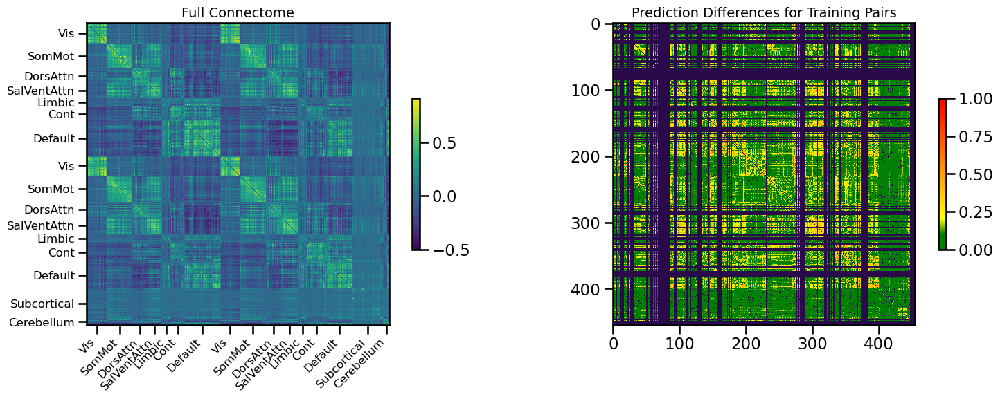

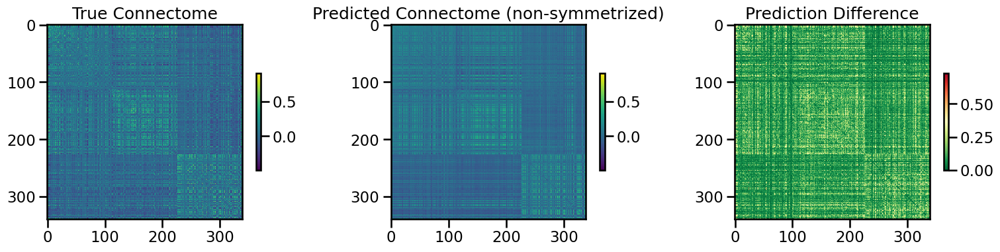

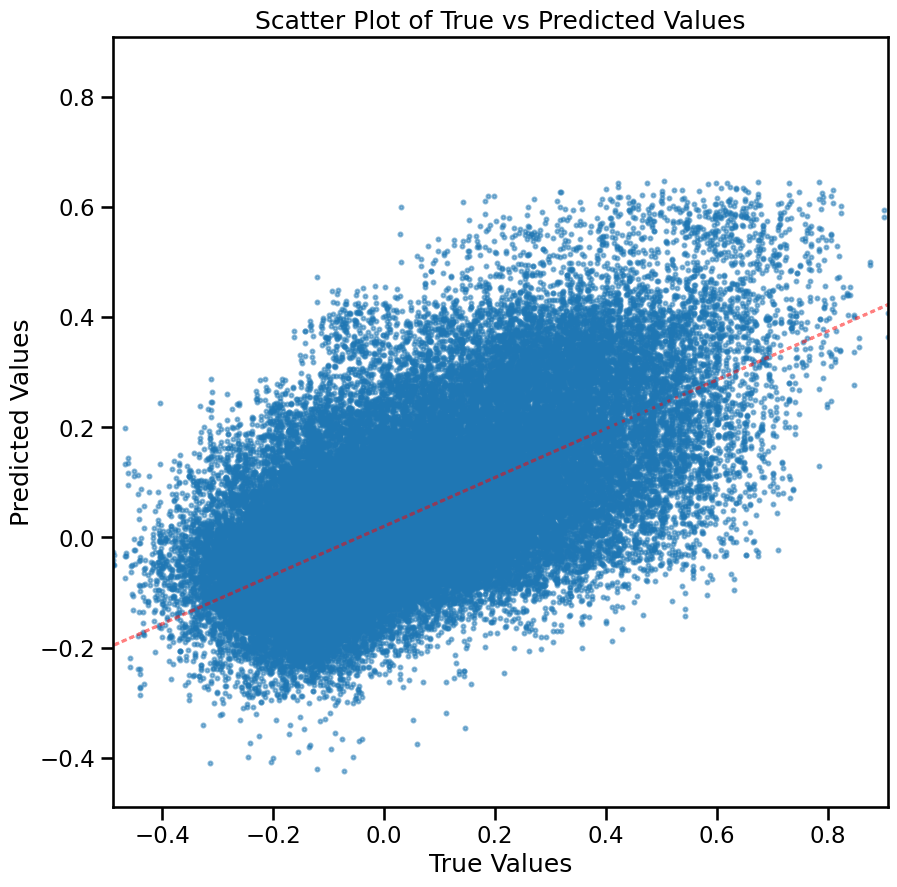

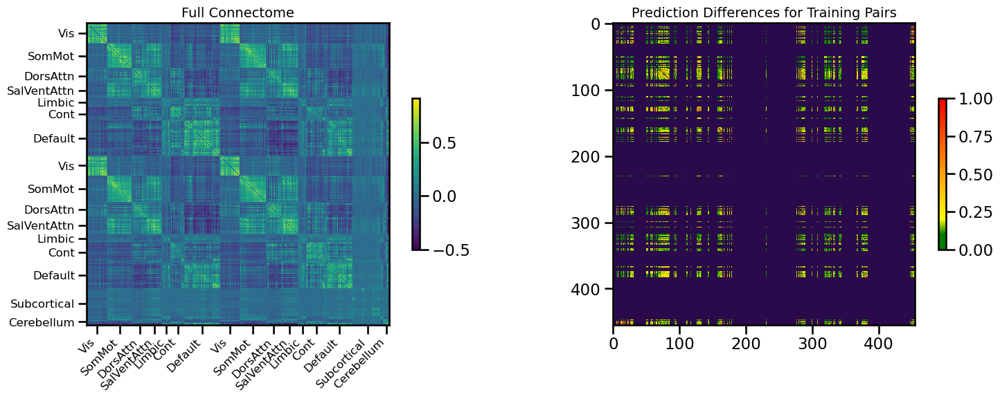

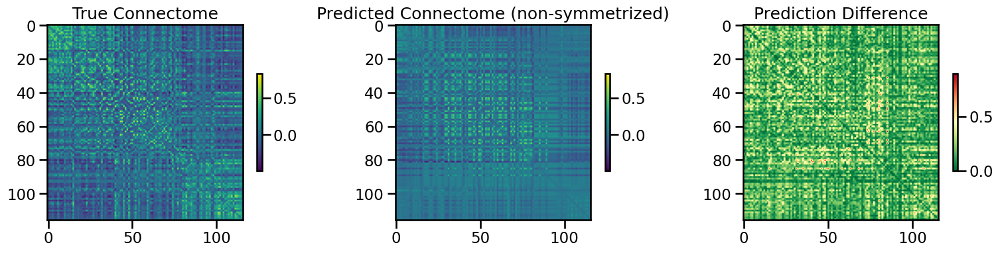

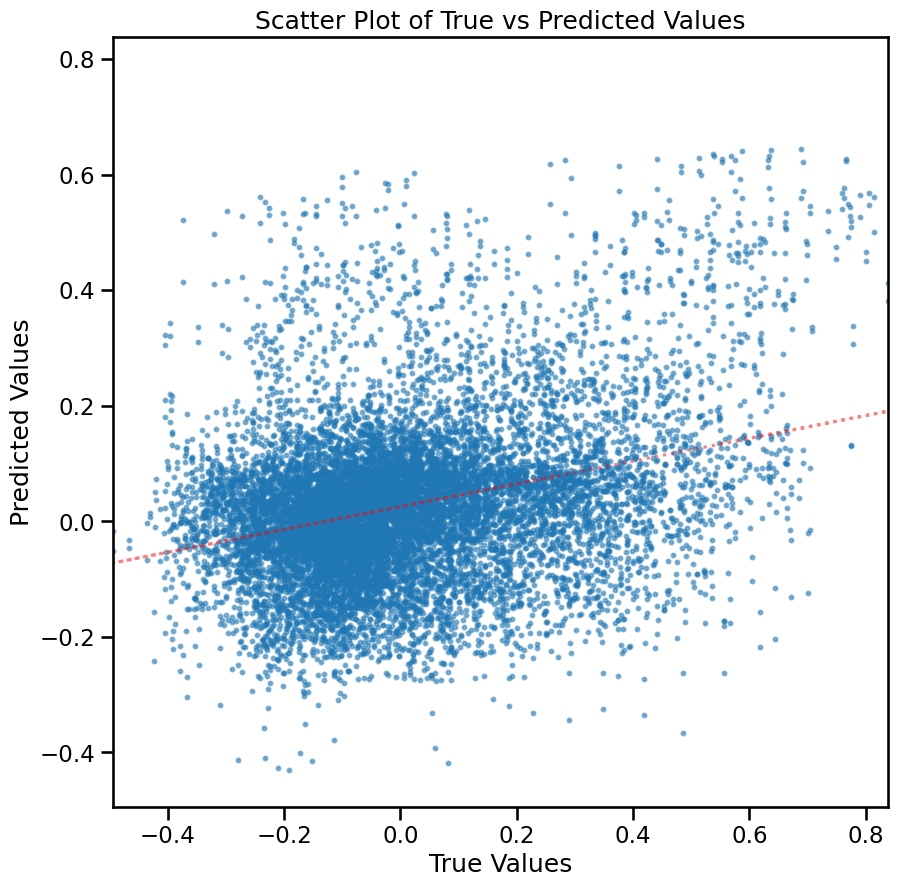

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.



TRAIN METRICS: {'mse': 0.019571029, 'mae': 0.10099983, 'r2': 0.38996222803785874, 'pearson_corr': 0.6293140379350706, 'geodesic_distance': 28.36233979789676}
TEST METRICS: {'mse': 0.047071245, 'mae': 0.16875823, 'r2': -0.026283943059136616, 'pearson_corr': 0.30610745501999237, 'geodesic_distance': 20.18379756345385}
BEST VAL SCORE 0.027904670909047125
BEST MODEL HYPERPARAMS {'input_dim': 7380, 'binarize': False, 'token_encoder_dim': 30, 'd_model': 64, 'encoder_output_dim': 10, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'use_positional_encoding': False, 'transformer_dropout': 0.1, 'dropout_rate': 0.2, 'learning_rate': 1e-05, 'weight_decay': 0.0001, 'lambda_reg': 0, 'batch_size': 512, 'epochs': 75}


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▃▃▃▁▁▂▁▃▃▂▃▄▃▄
train_mse_loss,█▅▄▃▃▃▂▂▂▂▂▂▁▁▁
best_val_loss,0.0279
test_mse_loss,0.04759
train_mse_loss,0.06748


Final evaluation metrics logged successfully.
CPU Usage: 18.3%
RAM Usage: 25.6%
Available RAM: 749.5G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  8% |


  gc.collect()



57844

In [9]:
# Run simulation
single_sim_run(
              cv_type='spatial',
              random_seed=42,
              model_type='shared_transformer_cls',
              feature_type=[{'transcriptome': None}],
              connectome_target='FC',
              binarize=False,
              use_gpu=True,
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              impute_strategy=None,
              sort_genes='expression',
              gene_list='0.2',
              hemisphere='both',
              search_method=('wandb', 'mse', 4),
              save_sim=False,
              track_wandb=True,
              skip_cv=False
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()